# Week 5A<br>Getting Data Part 1: Working with APIs
Oct 3, 2022

**Week #5 Agenda**

- Introduction to APIs
- Pulling census data and shape files using Python
    - Example: Lead poisoning in Philadelphia
- Using the Twitter API
    - Plotting geocoded tweets
    - Word frequencies
    - Sentiment analysis

**Important:** Update your local environment

- Small update to the course's Python environment
- Update the environment on your laptop using [these instructions](https://musa-550-fall-2022.github.io/guides/conda#updating-an-existing-environment) on course website

In [1]:
import geopandas as gpd
import pandas as pd
import numpy as np
from shapely.geometry import Point

from matplotlib import pyplot as plt
import seaborn as sns

import hvplot.pandas
import holoviews as hv

In [2]:
# Show all columns
pd.options.display.max_columns = 999

# Part 1: Introduction to APIs

Or, how to pull data from the web using Python

**Example APIs**

- Socrata Open Data: https://dev.socrata.com/
- Open Data Philly: https://opendataphilly.org
- US Census Bureau: https://www.census.gov/data/developers/data-sets.html

- Bureau of Labor Statistics: https://www.bls.gov/developers/
- US Geological Survey: https://www.usgs.gov/products/data-and-tools/apis
- US Environmental Protection Agency: https://www.epa.gov/enviro/web-services

- Google APIs: https://console.developers.google.com/apis/library?project=cp255-185021
- Facebook: https://developers.facebook.com/docs/apis-and-sdks/
- Twitter: https://developer.twitter.com/en/docs/api-reference-index.html

- Foursquare: https://developer.foursquare.com/
- Instagram: https://www.instagram.com/developer/
- Yelp: https://www.yelp.com/developers

**Note**: when accessing data via API, many services will require you to register an API key to prevent you from overloading the service with requests

##  Example #1: Automated data feeds

### USGS real-time earthquake feeds

This is an API for near-real-time data about earthquakes, and data is provided in GeoJSON format over the web. 

The API has a separate endpoint for each version of the data that users might want. No authentication is required.

API documentation:

http://earthquake.usgs.gov/earthquakes/feed/v1.0/geojson.php

Sample API endpoint, for magnitude 4.5+ earthquakes in past day:

http://earthquake.usgs.gov/earthquakes/feed/v1.0/summary/4.5_day.geojson

**Note:** GeoPandas can read GeoJSON from the web directly

Simply pass the URL to the `gpd.read_file()` function:

In [3]:
# Download data on magnitude 2.5+ quakes from the past week
endpoint_url = "http://earthquake.usgs.gov/earthquakes/feed/v1.0/summary/2.5_week.geojson"
df = gpd.read_file(endpoint_url)

In [4]:
df.head() 

,id,mag,place,time,updated,tz,url,detail,felt,cdi,mmi,alert,status,tsunami,sig,net,code,ids,sources,types,nst,dmin,rms,gap,magType,type,title,geometry
0,ak022d0be8a1,2.50,"63 km NNE of Aleneva, Alaska",1665423060572,1665423199047,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/earthquakes/feed/v...,NaN,NaN,NaN,None,automatic,0,96,ak,022d0be8a1,",ak022d0be8a1,",",ak,",",origin,phase-data,",NaN,NaN,0.53,NaN,ml,earthquake,"M 2.5 - 63 km NNE of Aleneva, Alaska",POINT Z (-152.40750 58.56650 6.70000)
1,us6000isic,5.00,"146 km ESE of Kokopo, Papua New Guinea",1665418172045,1665419288040,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/earthquakes/feed/v...,NaN,NaN,NaN,None,reviewed,0,385,us,6000isic,",us6000isic,",",us,",",origin,phase-data,",48.0,7.791,0.44,95.0,mb,earthquake,"M 5.0 - 146 km ESE of Kokopo, Papua New Guinea",POINT Z (153.51260 -4.79460 76.60300)
2,ak022d0am9ta,3.70,"43 km W of Cohoe, Alaska",1665417657235,1665421655030,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/earthquakes/feed/v...,8.0,3.1,2.796,None,reviewed,0,213,ak,022d0am9ta,",ak022d0am9ta,us6000isib,",",ak,us,",",dyfi,origin,phase-data,shakemap,",NaN,NaN,0.38,NaN,ml,earthquake,"M 3.7 - 43 km W of Cohoe, Alaska",POINT Z (-152.08850 60.44080 81.30000)
3,pr71375998,2.88,"33 km SSW of Esperanza, Puerto Rico",1665416302150,1665422030964,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/earthquakes/feed/v...,2.0,2.2,NaN,None,reviewed,0,128,pr,71375998,",pr71375998,",",pr,",",dyfi,origin,phase-data,",19.0,NaN,0.35,191.0,md,earthquake,"M 2.9 - 33 km SSW of Esperanza, Puerto Rico",POINT Z (-65.57533 17.80767 10.73000)
4,us6000isi2,4.60,Reykjanes Ridge,1665408230842,1665415781040,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/earthquakes/feed/v...,NaN,NaN,NaN,None,reviewed,0,326,us,6000isi2,",us6000isi2,",",us,",",origin,phase-data,",93.0,9.219,0.42,137.0,mb,earthquake,M 4.6 - Reykjanes Ridge,POINT Z (-35.19700 53.77160 10.00000)


**Let's plot them on a map:**

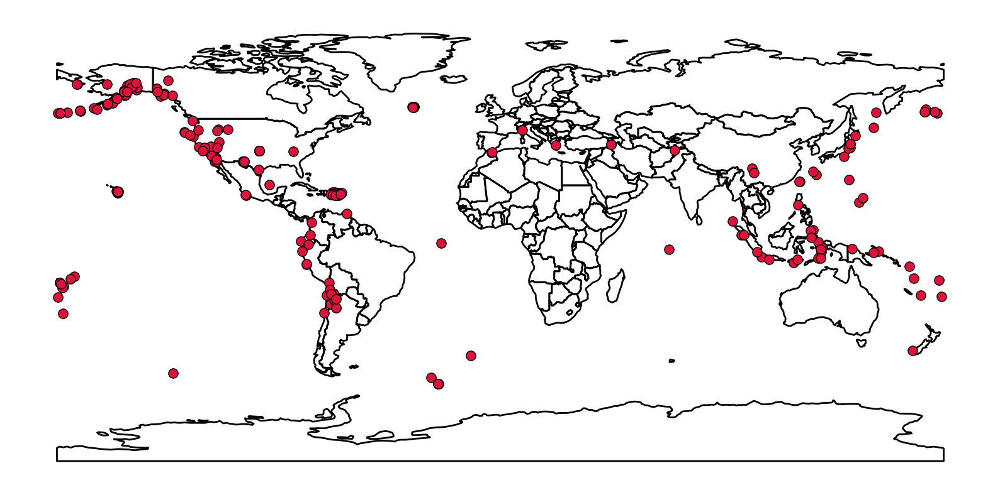

In [5]:
fig, ax = plt.subplots(figsize=(10, 10))

# plot the country outline
world = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))
world.plot(ax=ax, facecolor="none", edgecolor="black")

# plot the earthquakes
df.plot(ax=ax, color="crimson", markersize=30, edgecolor='k', linewidth=0.5)

ax.set_axis_off()

## Example #2: GeoServices

A GeoService is a standardized format for returning GeoJSON files over the web.

Documentation http://geoservices.github.io/

OpenDataPhilly provides GeoService API endpoints for the geometry hosted on its platform

###  Philadelphia ZIP codes

https://www.opendataphilly.org/dataset/zip-codes

In [6]:
# base URL
url = "https://services.arcgis.com/fLeGjb7u4uXqeF9q/arcgis/rest/services/Zipcodes_Poly/FeatureServer/0/"

###  Small utility package to make querying GeoServices easier: `esri2gpd`

https://github.com/PhiladelphiaController/esri2gpd

In [7]:
import esri2gpd

In [8]:
zip_codes = esri2gpd.get(url)

In [9]:
zip_codes.head()

,geometry,OBJECTID,CODE,COD,Shape__Area,Shape__Length
0,"POLYGON ((-75.11107 40.04682, -75.11206 40.047...",1,19120,20,9.177970e+07,49921.544063
1,"POLYGON ((-75.19227 39.99463, -75.19240 39.994...",2,19121,21,6.959879e+07,39534.887217
2,"POLYGON ((-75.15406 39.98601, -75.15494 39.986...",3,19122,22,3.591632e+07,24124.645221
3,"POLYGON ((-75.15190 39.97056, -75.15258 39.970...",4,19123,23,3.585175e+07,26421.728982
4,"POLYGON ((-75.09660 40.04249, -75.09661 40.042...",5,19124,24,1.448080e+08,63658.770420


In [10]:
zip_codes.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

**Let's plot it**

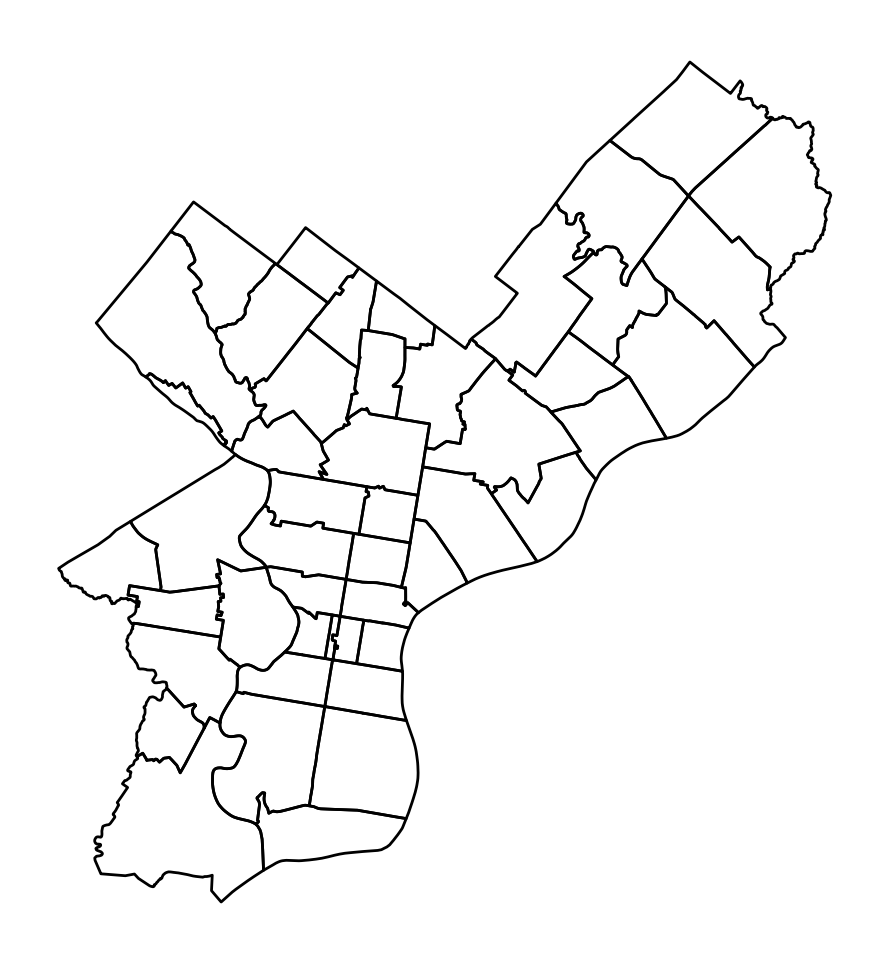

In [11]:
fig, ax = plt.subplots(figsize=(6, 6))
zip_codes.to_crs(epsg=3857).plot(ax=ax, facecolor="none", edgecolor="black")
ax.set_axis_off()

### Another useful example: census tracts

https://www.opendataphilly.org/dataset/census-tracts

## Example #3: Downloading Philly data from CARTO

- Philadelphia hosts the majority of its open data in the cloud using CARTO. 
- They provide an API to download the data
- You can access the API documentation from OpenDataPhilly

**Note: the "API documentation" on OpenDataPhilly will link to the documentation for the CARTO database**

For example: shooting victims in Philadelphia

https://www.opendataphilly.org/dataset/shooting-victims

**Download link on Open Data Philly is just querying an API!**

`https://phl.carto.com/api/v2/sql?q=SELECT+*,+ST_Y(the_geom)+AS+lat,+ST_X(the_geom)+AS+lng+FROM+shootings&filename=shootings&format=csv&skipfields=cartodb_id`

- First line: the base URL for CARTO
- Second line: the SQL query

### SQL Databases

The CARTO databases can be queried using SQL. This allows you to select specific data from the larger database.

CARTO API documentation: https://carto.com/developers/sql-api/

SQL documentation: https://www.postgresql.org/docs/9.1/sql.html

### General Query Syntax

`SELECT [field names] FROM [table name] WHERE [query]`

### Let's try it out in Python

We'll use Python's `requests` library to query the API endpoint with our desired query.

In [12]:
import requests

In [13]:
# the API end point
API_endpoint = "https://phl.carto.com/api/v2/sql"

# the query
query = "SELECT * FROM shootings" # table name is "shootings"

# desired format of the returned features
output_format = 'geojson'

# fields to skip
skipfields = ["cartodb_id"]

In [14]:
# all of our request parameters
params = dict(q=query, format=output_format, skipfields=skipfields)

params

{'q': 'SELECT * FROM shootings',
 'format': 'geojson',
 'skipfields': ['cartodb_id']}

In [15]:
# make the request
r = requests.get(API_endpoint, params=params)

r

<Response [200]>

In [16]:
# Get the returned data in JSON format
# This is a dictionary
features = r.json()

In [17]:
type(features)

dict

In [18]:
# What are the keys?
list(features.keys())

['type', 'features']

In [19]:
features['type']

'FeatureCollection'

In [20]:
# Let's look at the first feature
features['features'][0]

{'type': 'Feature',
 'geometry': {'type': 'Point', 'coordinates': [-75.160058, 39.991636]},
 'properties': {'objectid': 5540209,
  'year': 2020,
  'dc_key': '202022043328.0',
  'code': '411',
  'date_': '2020-06-19T00:00:00Z',
  'time': '23:45:00',
  'race': 'B',
  'sex': 'M',
  'age': '32',
  'wound': 'Leg',
  'officer_involved': 'N',
  'offender_injured': 'N',
  'offender_deceased': 'N',
  'location': '2500 BLOCK N 17TH ST',
  'latino': 0,
  'point_x': None,
  'point_y': None,
  'dist': '22',
  'inside': 0,
  'outside': 1,
  'fatal': 0}}

Use the `GeoDataFrame.from_features()` function to create a GeoDataFrame.

**Don't forget to specify the CRS of the input data!**

In [21]:
shootings = gpd.GeoDataFrame.from_features(features, crs="EPSG:4326")

In [22]:
shootings.head()

,geometry,objectid,year,dc_key,code,date_,time,race,sex,age,wound,officer_involved,offender_injured,offender_deceased,location,latino,point_x,point_y,dist,inside,outside,fatal
0,POINT (-75.16006 39.99164),5540209,2020,202022043328.0,411,2020-06-19T00:00:00Z,23:45:00,B,M,32,Leg,N,N,N,2500 BLOCK N 17TH ST,0.0,NaN,NaN,22,0.0,1.0,0.0
1,POINT (-75.18019 39.98646),5540210,2020,202022043831.0,411,2020-06-22T00:00:00Z,02:00:00,B,M,26,Multiple,N,N,N,2800 BLOCK SEDGLEY AVE,0.0,NaN,NaN,22,0.0,1.0,0.0
2,POINT (-75.18512 39.99001),5540211,2020,202022044523.0,411,2020-06-25T00:00:00Z,00:00:00,B,M,44,MULTI,N,N,N,3200 BLOCK SUSQUEHANNA AV,0.0,NaN,NaN,22,0.0,1.0,0.0
3,POINT (-75.17896 39.99545),5540212,2020,202022044909.0,411,2020-06-26T00:00:00Z,19:44:00,B,M,26,LEG,N,N,N,2900 BLOCK W HUNTINGDON ST,0.0,NaN,NaN,22,0.0,1.0,0.0
4,POINT (-75.17896 39.99545),5540213,2020,202022044910.0,411,2020-06-26T00:00:00Z,19:44:00,B,M,43,ABDOMEN,N,N,N,2900 BLOCK W HUNTINGDON ST,0.0,NaN,NaN,22,0.0,1.0,0.0


### At-Home Exercise: Visualizing shootings data

#### Step 1: Prep the data

- Drop rows where the geometry is NaN
- Convert to a better CRS (e.g., 3857)
- Trim to those only within city limits (some shootings have wrong coordinates, outside Philadelphia!)

In [23]:
# Load the city limits from open data philly
city_limits = gpd.read_file(
    "https://opendata.arcgis.com/datasets/405ec3da942d4e20869d4e1449a2be48_0.geojson"
).to_crs(epsg=3857)

In [24]:
# make sure we remove missing geometries
shootings = shootings.dropna(subset=['geometry'])

# convert to a better CRS
shootings = shootings.to_crs(epsg=3857)

In [25]:
# Remove any shootings that are outside the city limits
shootings = gpd.sjoin(shootings, city_limits, predicate='within', how='inner').drop(columns=['index_right'])

#### Step 2: Plot the points

A quick plot with geopandas to show the shootings as points

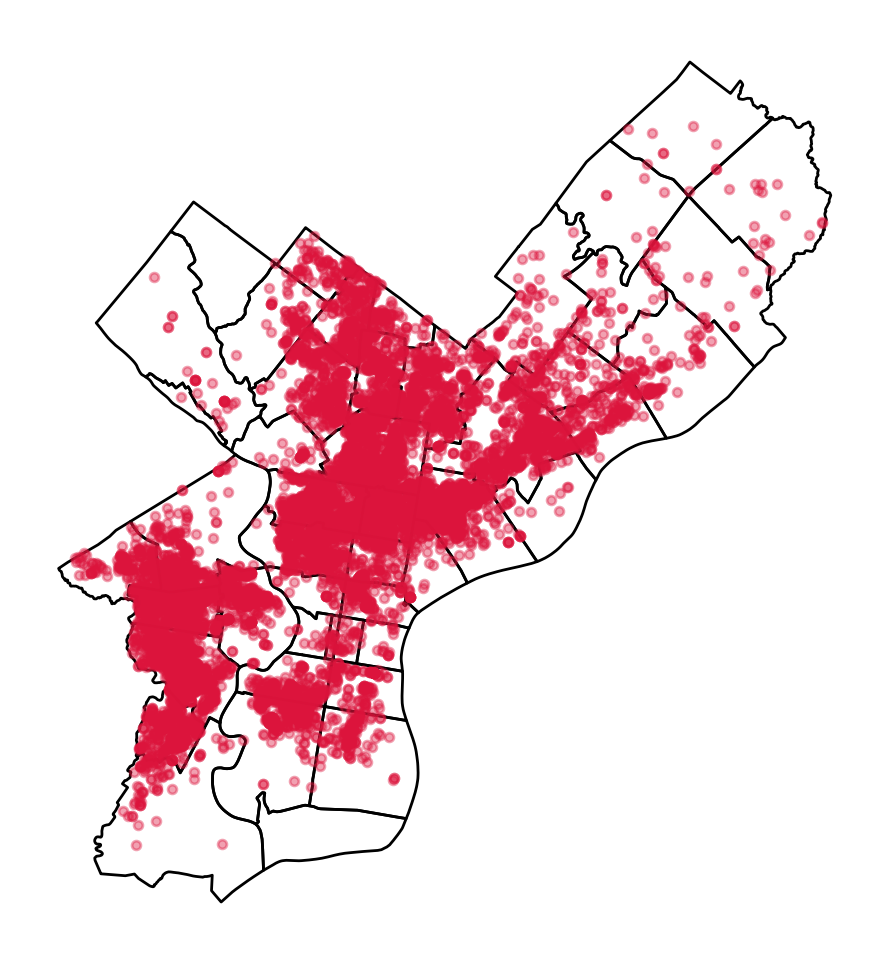

In [26]:
fig, ax = plt.subplots(figsize=(6, 6))

# ZIP codes
zip_codes.to_crs(epsg=3857).plot(ax=ax, facecolor="none", edgecolor="black")

# Shootings
shootings.plot(ax=ax, color="crimson", markersize=10, alpha=0.4)
ax.set_axis_off()

#### Step 3: Make a (more useful) hex bin map

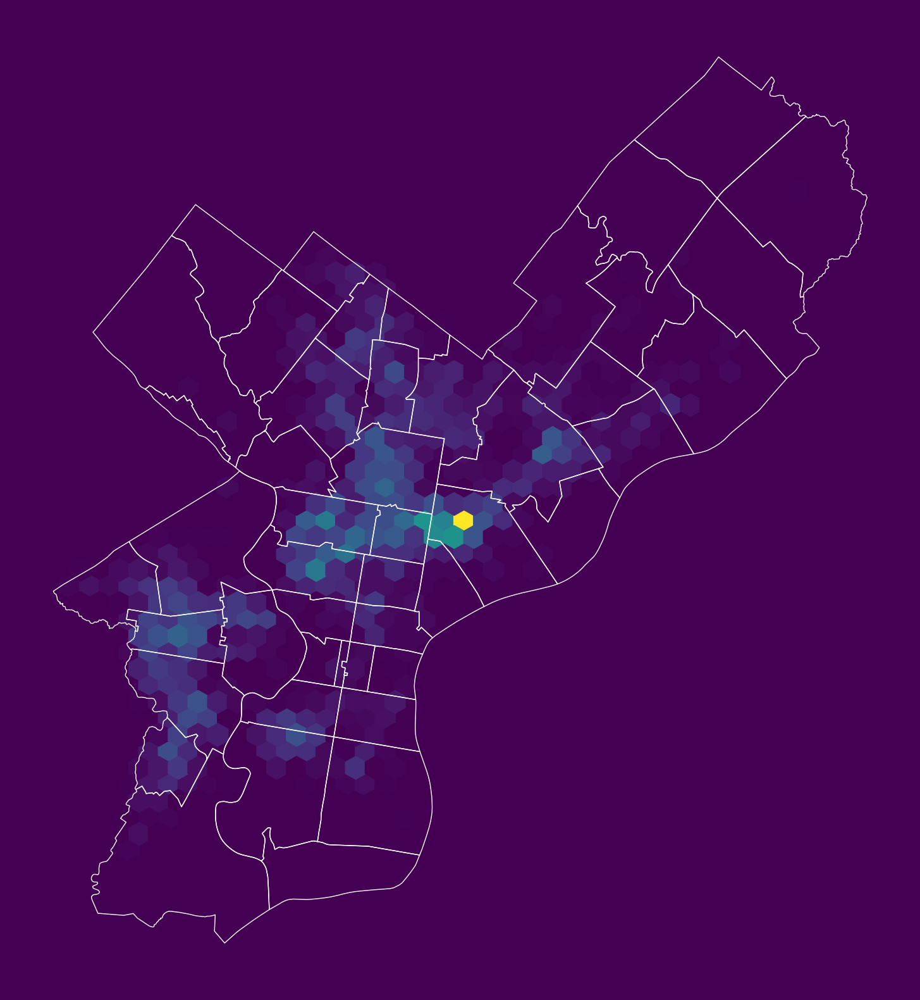

In [27]:
# initialize the axes
fig, ax = plt.subplots(figsize=(10, 10), facecolor=plt.get_cmap('viridis')(0))

# convert to Web Mercator and plot the hexbins 
x = shootings.geometry.x
y = shootings.geometry.y
ax.hexbin(x, y, gridsize=40, mincnt=1, cmap='viridis')

# overlay the ZIP codes
zip_codes.to_crs(epsg=3857).plot(ax=ax, 
                                 facecolor='none', 
                                 linewidth=0.5,
                                 edgecolor='white')

ax.set_axis_off()

### Count the total number of rows in a table

The `COUNT` function can be applied to count all rows.

In [28]:
query = "SELECT COUNT(*) FROM shootings"

In [29]:
params = dict(q=query)
r = requests.get(API_endpoint, params=params)

In [30]:
r.json()

{'rows': [{'count': 13269}],
 'time': 0.003,
 'fields': {'count': {'type': 'number', 'pgtype': 'int8'}},
 'total_rows': 1}

**Important:** always good to check how many rows you might be downloading before hand.

### Select all columns, limiting the total number returned

The `LIMIT` function limits the number of returned rows. It is very useful for taking a quick look at the format of a database.

In [31]:
# select the first 5
query = "SELECT * FROM shootings LIMIT 5"

In [32]:
params = dict(q=query, format="geojson")
r = requests.get(API_endpoint, params=params)

In [33]:
df = gpd.GeoDataFrame.from_features(r.json(), crs="EPSG:4326")
df

,geometry,cartodb_id,objectid,year,dc_key,code,date_,time,race,sex,age,wound,officer_involved,offender_injured,offender_deceased,location,latino,point_x,point_y,dist,inside,outside,fatal
0,POINT (-75.16006 39.99164),1,5540209,2020,202022043328.0,411,2020-06-19T00:00:00Z,23:45:00,B,M,32,Leg,N,N,N,2500 BLOCK N 17TH ST,0,None,None,22,0,1,0
1,POINT (-75.18019 39.98646),2,5540210,2020,202022043831.0,411,2020-06-22T00:00:00Z,02:00:00,B,M,26,Multiple,N,N,N,2800 BLOCK SEDGLEY AVE,0,None,None,22,0,1,0
2,POINT (-75.18512 39.99001),3,5540211,2020,202022044523.0,411,2020-06-25T00:00:00Z,00:00:00,B,M,44,MULTI,N,N,N,3200 BLOCK SUSQUEHANNA AV,0,None,None,22,0,1,0
3,POINT (-75.17896 39.99545),4,5540212,2020,202022044909.0,411,2020-06-26T00:00:00Z,19:44:00,B,M,26,LEG,N,N,N,2900 BLOCK W HUNTINGDON ST,0,None,None,22,0,1,0
4,POINT (-75.17896 39.99545),5,5540213,2020,202022044910.0,411,2020-06-26T00:00:00Z,19:44:00,B,M,43,ABDOMEN,N,N,N,2900 BLOCK W HUNTINGDON ST,0,None,None,22,0,1,0


### Select by specific column values

In [34]:
shootings.head()

,geometry,objectid,year,dc_key,code,date_,time,race,sex,age,wound,officer_involved,offender_injured,offender_deceased,location,latino,point_x,point_y,dist,inside,outside,fatal,OBJECTID,Shape__Area,Shape__Length
0,POINT (-8366779.385 4864726.920),5540209,2020,202022043328.0,411,2020-06-19T00:00:00Z,23:45:00,B,M,32,Leg,N,N,N,2500 BLOCK N 17TH ST,0.0,NaN,NaN,22,0.0,1.0,0.0,1,3.970706e+09,394751.12047
1,POINT (-8369020.246 4863975.169),5540210,2020,202022043831.0,411,2020-06-22T00:00:00Z,02:00:00,B,M,26,Multiple,N,N,N,2800 BLOCK SEDGLEY AVE,0.0,NaN,NaN,22,0.0,1.0,0.0,1,3.970706e+09,394751.12047
2,POINT (-8369568.940 4864490.085),5540211,2020,202022044523.0,411,2020-06-25T00:00:00Z,00:00:00,B,M,44,MULTI,N,N,N,3200 BLOCK SUSQUEHANNA AV,0.0,NaN,NaN,22,0.0,1.0,0.0,1,3.970706e+09,394751.12047
3,POINT (-8368883.100 4865281.544),5540212,2020,202022044909.0,411,2020-06-26T00:00:00Z,19:44:00,B,M,26,LEG,N,N,N,2900 BLOCK W HUNTINGDON ST,0.0,NaN,NaN,22,0.0,1.0,0.0,1,3.970706e+09,394751.12047
4,POINT (-8368883.100 4865281.544),5540213,2020,202022044910.0,411,2020-06-26T00:00:00Z,19:44:00,B,M,43,ABDOMEN,N,N,N,2900 BLOCK W HUNTINGDON ST,0.0,NaN,NaN,22,0.0,1.0,0.0,1,3.970706e+09,394751.12047


**Select nonfatal shootings only**

In [35]:
query = "SELECT * FROM shootings WHERE fatal = 0" 

In [36]:
# Make the request
params = dict(q=query, format="geojson")
r = requests.get(API_endpoint, params=params)

# Make the GeoDataFrame
fatal = gpd.GeoDataFrame.from_features(r.json(), crs="EPSG:4326")
print("number of nonfatal shootings = ", len(fatal))

number of nonfatal shootings =  10453


**Select shootings in 2022**

In [37]:
query = "SELECT * FROM shootings WHERE date_ > '12/31/21'"

In [38]:
# Make the request
params = dict(q=query, format="geojson")
r = requests.get(API_endpoint, params=params)

# Make the GeoDataFrame
this_year = gpd.GeoDataFrame.from_features(r.json(), crs="EPSG:4326")
print("number of shootings this year = ", len(this_year))

number of shootings this year =  1850


### The easier way: `carto2gpd`

- A small utility library to simplify the querying of CARTO APIs.
- The `get()` function will query the database
- The `get_size()` function will use `COUNT()` to get the total number of rows

https://github.com/PhiladelphiaController/carto2gpd

In [39]:
import carto2gpd

In [40]:
where = "date_ > '12/31/21' and fatal = 0"
df = carto2gpd.get(API_endpoint, 'shootings', where=where)

In [41]:
df.head()

,geometry,cartodb_id,objectid,year,dc_key,code,date_,time,race,sex,age,wound,officer_involved,offender_injured,offender_deceased,location,latino,point_x,point_y,dist,inside,outside,fatal
0,POINT (-75.12066 40.03026),371,5545192,2022,202235024216.0,401,2022-05-03T00:00:00Z,19:23:00,A,M,24,Foot,N,N,N,100 BLOCK E FISHER AVE,0,None,None,35,0,1,0
1,None,372,5545193,2022,202235025800.0,401,2022-05-10T00:00:00Z,16:50:00,A,M,27,Multiple,N,N,N,1300 BLOCK W ROCKLNAD ST,0,None,None,35,0,1,0
2,POINT (-75.14509 40.02738),373,5545194,2022,202235025800.0,401,2022-05-10T00:00:00Z,16:50:00,B,M,27,Multiple,N,N,N,1300 BLOCK W ROCKLAND ST,0,None,None,35,0,1,0
3,POINT (-75.14509 40.02738),374,5545195,2022,202235025800.0,401,2022-05-10T00:00:00Z,16:50:00,B,M,41,Foot,N,N,N,1300 BLOCK W ROCKLAND ST,0,None,None,35,0,1,0
4,POINT (-75.13656 40.02895),375,5545196,2022,202235027022.0,401,2022-05-16T00:00:00Z,17:08:00,B,M,34,Leg,N,N,N,5000 BLOCK N FRANKLIN ST,0,None,None,35,0,1,0


In [42]:
# Limit results to the first 5
df = carto2gpd.get(API_endpoint, 'shootings', limit=5)

In [43]:
len(df)

5

In [44]:
df

,geometry,cartodb_id,objectid,year,dc_key,code,date_,time,race,sex,age,wound,officer_involved,offender_injured,offender_deceased,location,latino,point_x,point_y,dist,inside,outside,fatal
0,POINT (-75.16006 39.99164),1,5540209,2020,202022043328.0,411,2020-06-19T00:00:00Z,23:45:00,B,M,32,Leg,N,N,N,2500 BLOCK N 17TH ST,0,None,None,22,0,1,0
1,POINT (-75.18019 39.98646),2,5540210,2020,202022043831.0,411,2020-06-22T00:00:00Z,02:00:00,B,M,26,Multiple,N,N,N,2800 BLOCK SEDGLEY AVE,0,None,None,22,0,1,0
2,POINT (-75.18512 39.99001),3,5540211,2020,202022044523.0,411,2020-06-25T00:00:00Z,00:00:00,B,M,44,MULTI,N,N,N,3200 BLOCK SUSQUEHANNA AV,0,None,None,22,0,1,0
3,POINT (-75.17896 39.99545),4,5540212,2020,202022044909.0,411,2020-06-26T00:00:00Z,19:44:00,B,M,26,LEG,N,N,N,2900 BLOCK W HUNTINGDON ST,0,None,None,22,0,1,0
4,POINT (-75.17896 39.99545),5,5540213,2020,202022044910.0,411,2020-06-26T00:00:00Z,19:44:00,B,M,43,ABDOMEN,N,N,N,2900 BLOCK W HUNTINGDON ST,0,None,None,22,0,1,0


In [45]:
size = carto2gpd.get_size(API_endpoint, 'shootings')
print(size)

13269


### At-Home Exercise: Explore trends by month and day of week

#### Step 1: Convert the date column to `DateTime` objects

Add Month and Day of Week columns

In [46]:
# Convert the data column to a datetime object
shootings['date'] = pd.to_datetime(shootings['date_'])

In [47]:
# Add new columns: Month and Day of Week
shootings["Month"] = shootings["date"].dt.month
shootings["Day of Week"] = shootings["date"].dt.dayofweek # Monday is 0, Sunday is 6

#### Step 2: Calculate number of shootings by month and day of week

Use the familiar Groupby --> size()

In [48]:
count = shootings.groupby(['Month', 'Day of Week']).size()
count = count.reset_index(name='Count')
count.head()

,Month,Day of Week,Count
0,1,0,135
1,1,1,129
2,1,2,120
3,1,3,125
4,1,4,131


#### Step 3: Make a heatmap using `hvplot`

In [49]:
# Remember 0 is Monday and 6 is Sunday
count.hvplot.heatmap(
    x="Day of Week",
    y="Month",
    C="Count",
    cmap="viridis",
    width=400,
    height=500,
    flip_yaxis=True,
)

:HeatMap   [Day of Week,Month]   (Count)

#### Trends: more shootings on the weekends and in the summer months

## Part 2: The Census API

### US Census data is foundational

- Rich data sets with annual releases
- Decennial results plus American Community Survey (ACS) results
- Wide range of topics covered: sex, income, poverty, education, housing

### Getting census data (the old way)<br>American Factfinder

<center>
<a href=https://factfinder.census.gov><img src=attachment:Screen%20Shot%202019-02-19%20at%208.24.51%20PM.png width=700></img></a>
</center>
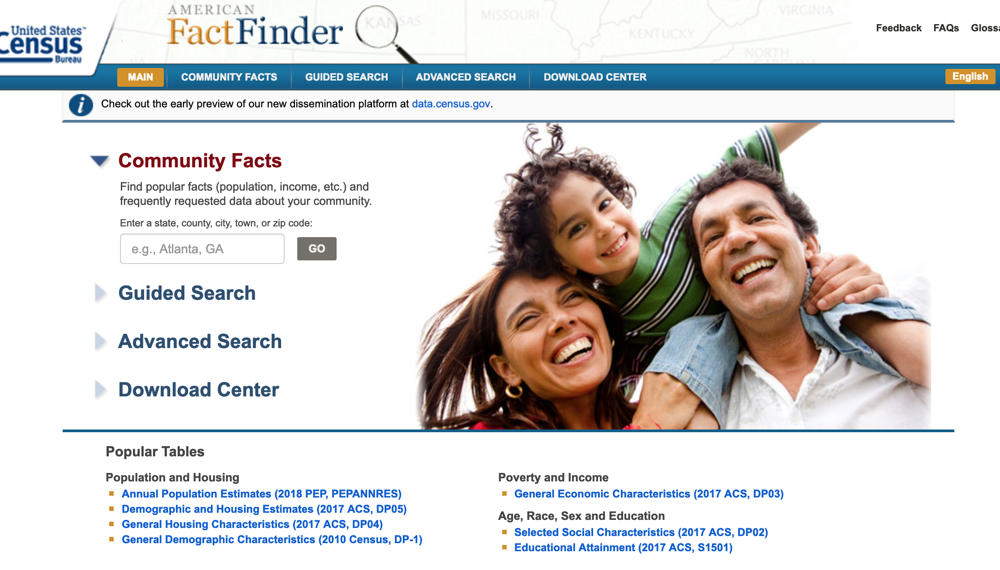

### Getting census data (the new way)<br>census.data.gov

<center>
    <a href=https://data.census.gov/><img src=attachment:Screen%20Shot%202019-02-19%20at%208.46.48%20PM.png width=700></img></a>
</center>
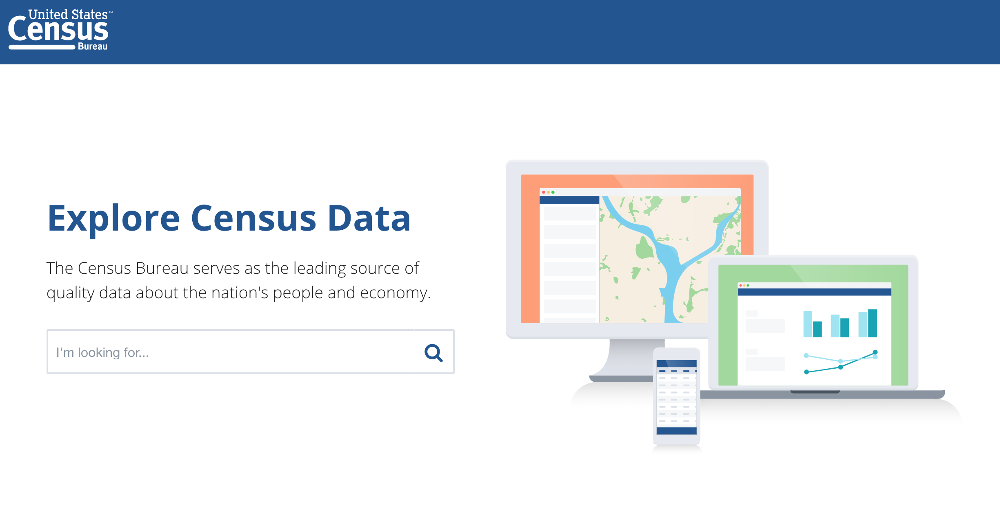

### Getting census data: other options

Several 3rd party options with easier interfaces for accessing census data

#### Data USA

<center>
<a href="https://datausa.io">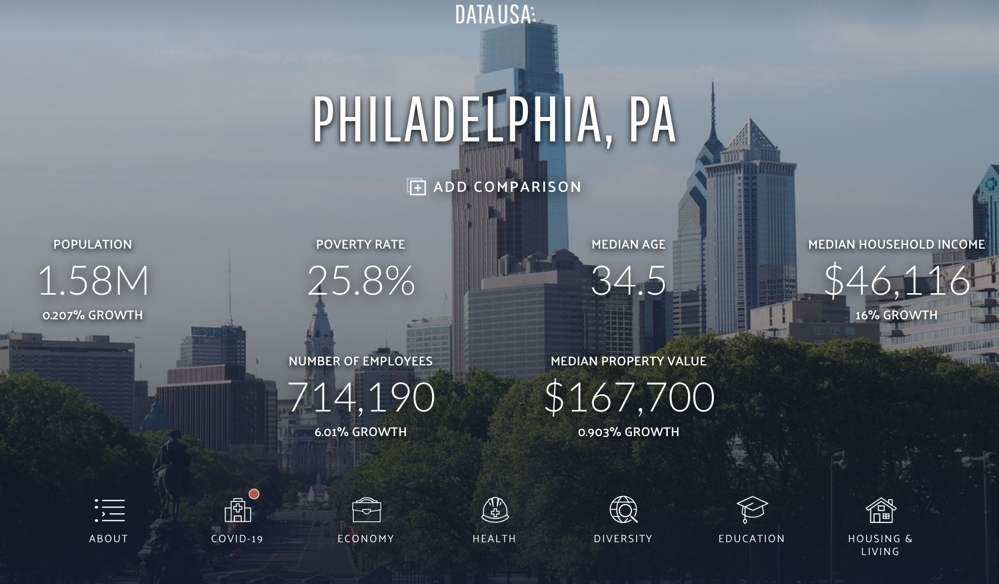</img></a>
</center>

#### Census Reporter: 

<center>
<a href=https://censusreporter.org><img src=attachment:Screen%20Shot%202019-02-19%20at%208.39.08%20PM.png width=700></img></a>
</center>
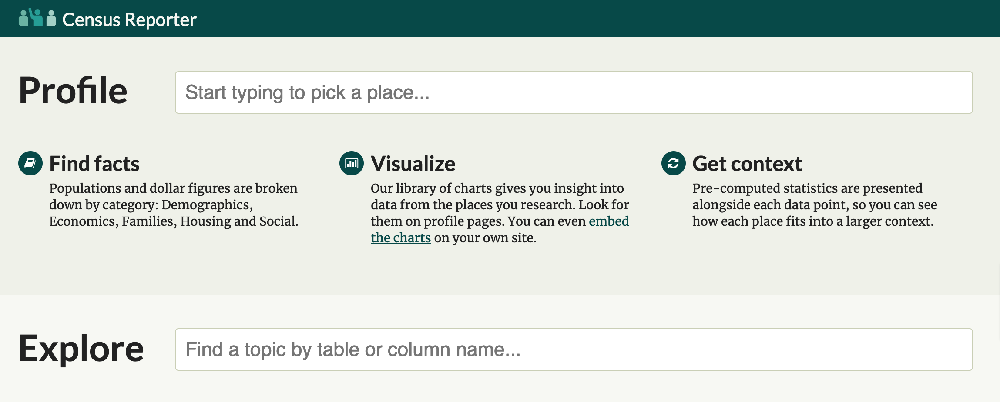

#### NHGIS

<center>
<a href= https://www.nhgis.org><img src=attachment:Screen%20Shot%202019-02-19%20at%208.35.51%20PM.png width=700></img></a>
</center>
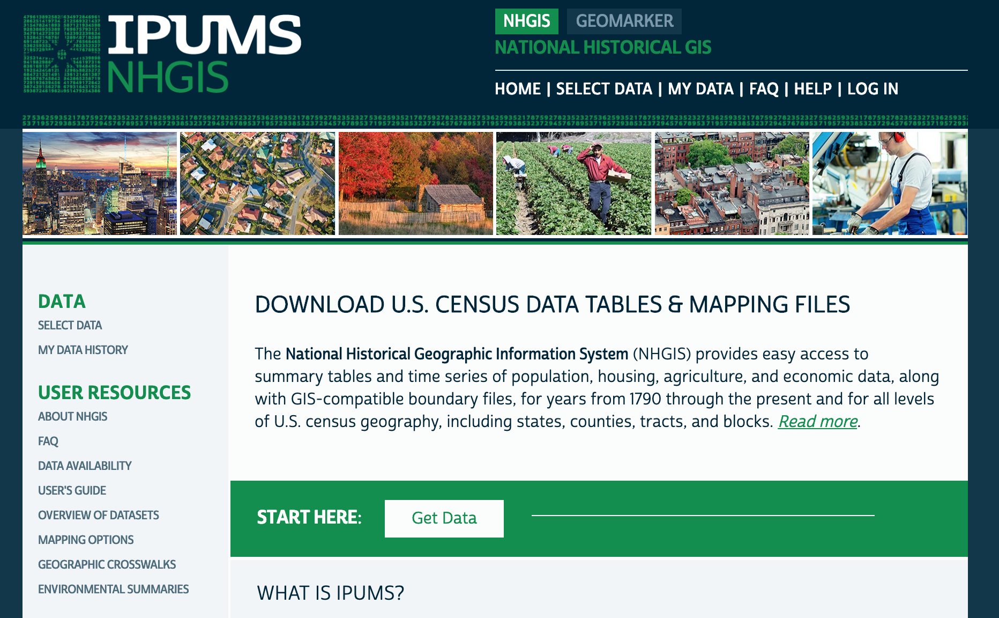

### Example: poverty data
<center>
    <a href="https://data.census.gov/cedsci/table?q=poverty%20status&g=0100000US%240400000&tid=ACSST1Y2021.S1701">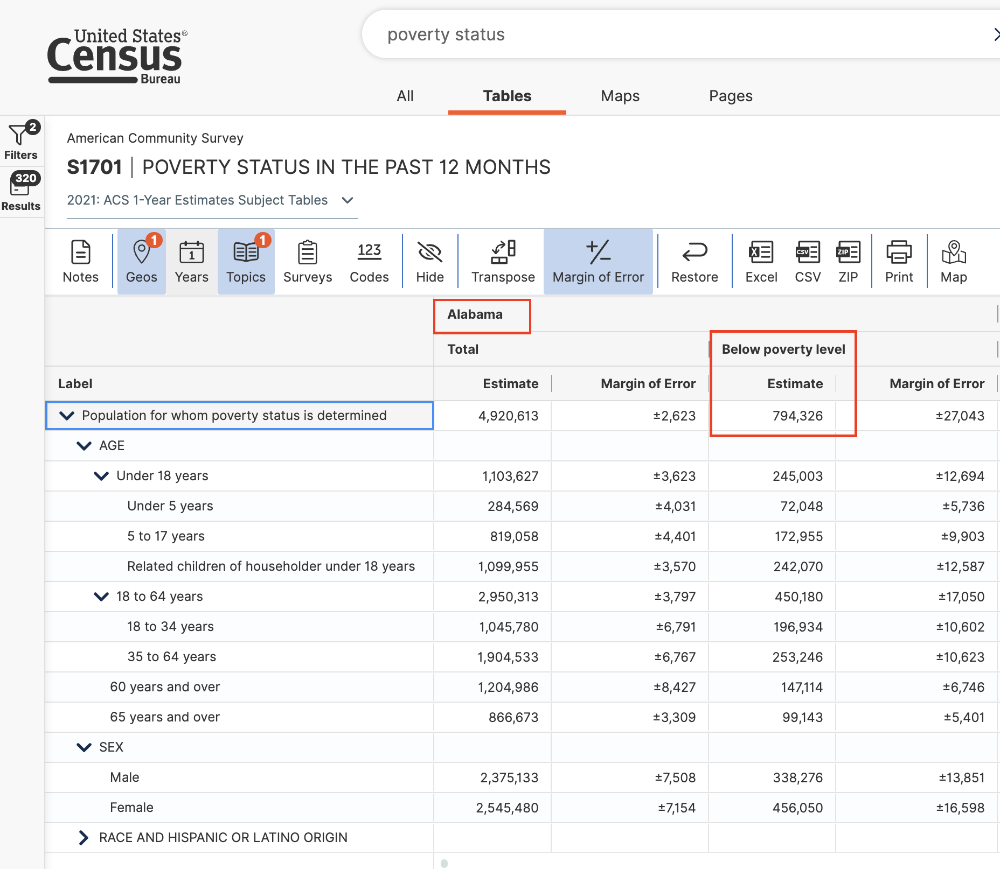</img></a>
</center>

#### Via the API

https://api.census.gov/data/2021/acs/acs1?get=NAME,B17001_002E&for=state:*

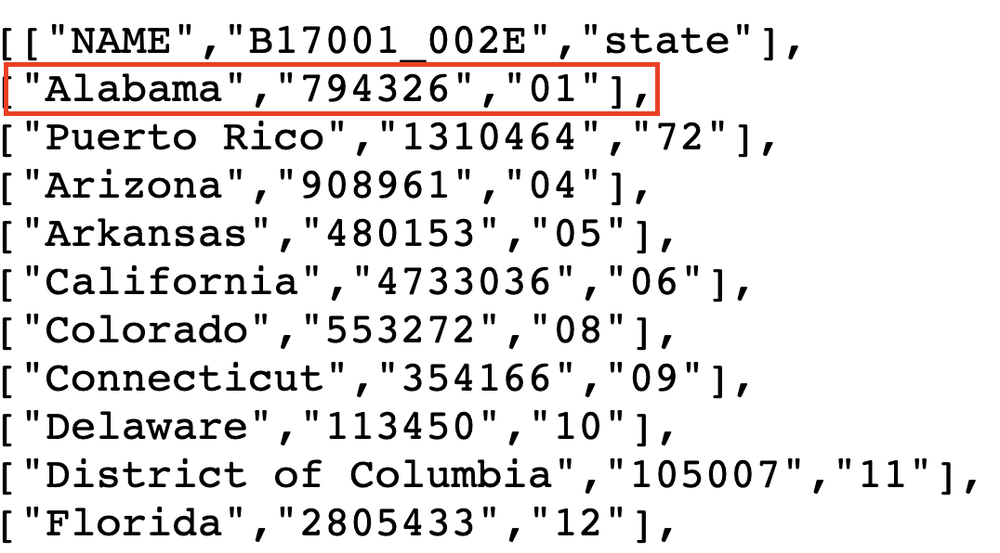

### How to find the right variable names?

The census provides web-based documentation:

- Overview of all data tables: https://api.census.gov/data.html
- All data tables for 2020: https://api.census.gov/data/2020.html
- All variables for 2020 ACS 5-year data set: https://api.census.gov/data/2020/acs/acs5/variables.html

### A detailed Census API guide

https://www.census.gov/data/developers/guidance/api-user-guide.html

### Accessing the API is easier from Python

Several packages provide easier Python interfaces to census data based on the census API.

We'll focus on **`cenpy` - "Explore and download data from Census APIs"**
 - [Documentation](https://cenpy-devs.github.io/cenpy/)
 - [GitHub](https://github.com/cenpy-devs/cenpy)

### Example: the racial "dot" map

<center>
    <img src=attachment:Screen%20Shot%202019-02-19%20at%2010.04.05%20PM.png width=900></img>
</center>

[Source](https://demographics.coopercenter.org/Racial-Dot-Map)
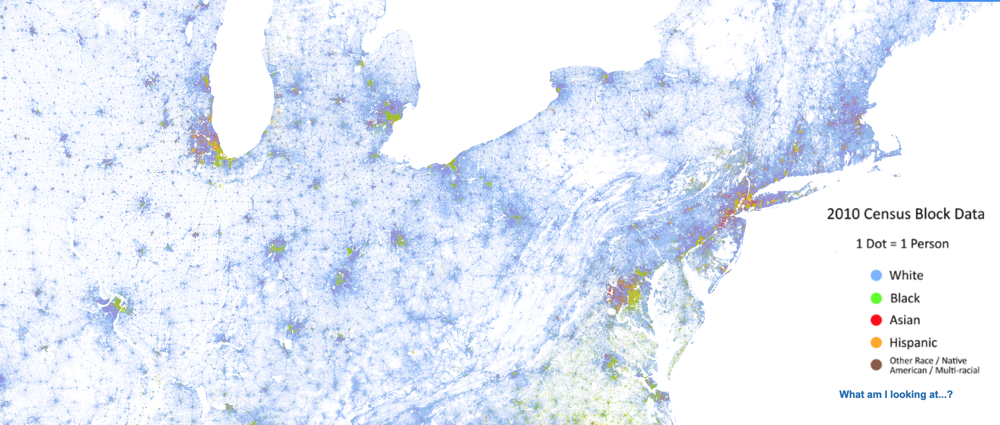

Let's make this for Philadelphia in Python!

In [50]:
# First step: import cenpy
import cenpy

#### The "explorer" module

Functions to help you explore the Census API from Python

- [`cenpy.explorer.available`](https://cenpy-devs.github.io/cenpy/generated/cenpy.explorer.available.html#cenpy.explorer.available): Returns information about available datasets in Census API
- [`cenpy.explorer.explain`](https://cenpy-devs.github.io/cenpy/generated/cenpy.explorer.explain.html#cenpy.explorer.explain): Explain a specific Census dataset
- [`cenpy.explorer.fips_table`](https://cenpy-devs.github.io/cenpy/generated/cenpy.explorer.fips_table.html#cenpy.explorer.fips_table): Get a table of FIPS codes for a specific geography

**Note: we can change pandas display options to see all rows/columns and large cells**

In [51]:
# UNCOMMENT TO SEE ALL ROWS/COLUMNS IN DATAFRAMES
# pd.options.display.max_rows = 9999 
# pd.options.display.max_colwidth = 200

#### Step 1: Identify what dataset we want

- Today, we'll use the 5-year American Community Survey (latest available year: 2019)
- Other common datasets: 
    - 1-year ACS datasets as well (latest available year: 2019)
    - 10-year decennial survey (latest available year: 2010)

In [52]:
available = cenpy.explorer.available()

available.head()

,c_isTimeseries,temporal,spatial,c_isAggregate,publisher,references,programCode,modified,license,keyword,identifier_url,contactPoint,distribution,description,bureauCode,accessLevel,title,c_isAvailable,c_isCube,c_isMicrodata,c_documentationLink,c_dataset,vintage
ABSCB2017,NaN,NaN,NaN,True,U.S. Census Bureau,https://www.census.gov/developers/,006:007,2020-04-30 00:00:00.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ABSCB2017,"{'fn': 'ASE Staff', 'hasEmail': 'mailto:erd.an...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The Annual Business Survey (ABS) provides info...,006:07,public,Economic Surveys: Annual Business Survey: Annu...,True,NaN,NaN,https://www.census.gov/developer/,"(abscb,)",2017.0
ABSCB2018,NaN,NaN,NaN,True,U.S. Census Bureau,https://www.census.gov/developers/,006:007,2020-10-26 00:00:00.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ABSCB2018,"{'fn': 'ASE Staff', 'hasEmail': 'mailto:Erd.an...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The Annual Business Survey (ABS) provides info...,006:07,public,Economic Surveys: Annual Business Survey: Annu...,True,NaN,NaN,https://www.census.gov/developer/,"(abscb,)",2018.0
ABSCB2019,NaN,NaN,NaN,True,U.S. Census Bureau,https://www.census.gov/developers/,006:007,2021-08-17 00:00:00.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ABSCB2019,"{'fn': 'ASE Staff', 'hasEmail': 'mailto:ERD.an...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The Annual Business Survey (ABS) provides info...,006:07,public,Economic Surveys: Annual Business Survey: Annu...,True,NaN,NaN,https://www.census.gov/developer/,"(abscb,)",2019.0
ABSCBO2017,NaN,NaN,NaN,True,U.S. Census Bureau,https://www.census.gov/developers/,006:007,2020-04-30 00:00:00.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ABSCBO2017,"{'fn': 'ASE Staff', 'hasEmail': 'mailto:erd.an...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The Annual Business Survey (ABS) provides info...,006:07,public,Economic Surveys: Annual Business Survey: Annu...,True,NaN,NaN,https://www.census.gov/developer/,"(abscbo,)",2017.0
ABSCBO2018,NaN,NaN,NaN,True,U.S. Census Bureau,https://www.census.gov/developers/,006:007,2020-10-26 00:00:00.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ABSCBO2018,"{'fn': 'ASE Staff', 'hasEmail': 'mailto:erd.an...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The Annual Business Survey (ABS) provides info...,006:07,public,Economic Surveys: Annual Business Survey: Annu...,True,NaN,NaN,https://www.census.gov/developer/,"(abscbo,)",2018.0


We can use the pandas [`filter()`](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.filter.html) to search for specific identifiers in the dataframe. 

In this case, let's search for the American Community Survey datasets. We'll match index labels using *regular expressions*. 

In particular, we'll search for labels that start with "ACS". In the language of regular expressions, we'll use the "^" to mean "match labels that start with"

For more info on regular expressions, the [documentation for the re module](https://docs.python.org/3/library/re.html) is a good place to start.

In [53]:
# Return a dataframe of all datasets that start with "ACS"
# Axis=0 means to filter the index labels!
acs = available.filter(regex="^ACS", axis=0)

acs

,c_isTimeseries,temporal,spatial,c_isAggregate,publisher,references,programCode,modified,license,keyword,identifier_url,contactPoint,distribution,description,bureauCode,accessLevel,title,c_isAvailable,c_isCube,c_isMicrodata,c_documentationLink,c_dataset,vintage
ACSCD1132011,NaN,2011/2011,United States,True,U.S. Census Bureau,http://www.census.gov/developers/,006:004,2014-10-06,http://creativecommons.org/publicdomain/zero/1.0/,"(census,)",http://api.census.gov/data/id/ACSCD1132011,"{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is a natio...,006:07,public,2011 American Community Survey 1-Year Profiles...,True,NaN,NaN,http://www.census.gov/developer/,"(acs1, cd113)",2011.0
ACSCD1152015,NaN,2015/2015,United States,True,U.S. Census Bureau,http://www.census.gov/developers/,006:004,2017-02-10,http://creativecommons.org/publicdomain/zero/1.0/,"(census,)",http://api.census.gov/data/id/ACSCD1152015,"{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,2015 American Community Survey 1-Year Data Pro...,True,NaN,NaN,http://www.census.gov/developer/,"(acs1, cd115)",2015.0
ACSCP1Y2010,NaN,NaN,United States,True,U.S. Census Bureau,https://www.census.gov/developers/,006:004,2018-09-18 00:00:00.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ACSCP1Y2010,"{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 1-Year Comparison Profiles,True,True,NaN,https://www.census.gov/developer/,"(acs, acs1, cprofile)",2010.0
ACSCP1Y2011,NaN,NaN,United States,True,U.S. Census Bureau,https://www.census.gov/developers/,006:004,2018-09-18 00:00:00.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ACSCP1Y2011,"{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 1-Year Comparison Profiles,True,True,NaN,https://www.census.gov/developer/,"(acs, acs1, cprofile)",2011.0
ACSCP1Y2012,NaN,NaN,NaN,True,U.S. Census Bureau,https://www.census.gov/developers/,006:004,2018-07-05 00:00:00.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ACSCP1Y2012,"{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 1-Year Comparison Profiles,True,True,NaN,https://www.census.gov/developer/,"(acs, acs1, cprofile)",2012.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ACSST5Y2016,NaN,NaN,NaN,True,U.S. Census Bureau,https://www.census.gov/developers/,006:004,2018-06-29 00:00:00.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ACSST5Y2016,"{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 5-Year Subject Tables,True,True,NaN,https://www.census.gov/developer/,"(acs, acs5, subject)",2016.0
ACSST5Y2017,NaN,NaN,NaN,True,U.S. Census Bureau,https://www.census.gov/developers/,006:004,2018-10-19 00:00:00.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ACSST5Y2017,"{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 5-Year Subject Tables,True,True,NaN,https://www.census.gov/developer/,"(acs, acs5, subject)",2017.0
ACSST5Y2018,NaN,NaN,NaN,True,U.S. Census Bureau,https://www.census.gov/developers/,006:004,2019-10-22 15:36:29.0,https://creativecommo

Many flavors of ACS datasets are available — we want to use the *detailed tables* version, specifically the 5-year survey. 

The relevant identifiers start with: "ACSDT5Y".

In [54]:
# Return a dataframe of all datasets that start with "ACSDT5Y"
available.filter(regex="^ACSDT5Y", axis=0)

,c_isTimeseries,temporal,spatial,c_isAggregate,publisher,references,programCode,modified,license,keyword,identifier_url,contactPoint,distribution,description,bureauCode,accessLevel,title,c_isAvailable,c_isCube,c_isMicrodata,c_documentationLink,c_dataset,vintage
ACSDT5Y2009,NaN,NaN,NaN,True,U.S. Census Bureau,https://www.census.gov/developers/,006:004,2019-08-27 13:11:18.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ACSDT5Y2009,"{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,American Community Survey: 5-Year Estimates: D...,True,True,NaN,https://www.census.gov/developer/,"(acs, acs5)",2009.0
ACSDT5Y2010,NaN,NaN,United States,True,U.S. Census Bureau,https://www.census.gov/developers/,006:004,2018-07-04 00:00:00.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ACSDT5Y2010,"{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 5-Year Detailed Tables,True,True,NaN,https://www.census.gov/developer/,"(acs, acs5)",2010.0
ACSDT5Y2011,NaN,NaN,NaN,True,U.S. Census Bureau,https://www.census.gov/developers/,006:004,2018-07-04 00:00:00.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ACSDT5Y2011,"{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 5-Year Detailed Tables,True,True,NaN,https://www.census.gov/developer/,"(acs, acs5)",2011.0
ACSDT5Y2012,NaN,NaN,NaN,True,U.S. Census Bureau,https://www.census.gov/developers/,006:004,2018-07-04 00:00:00.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ACSDT5Y2012,"{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 5-Year Detailed Tables,True,True,NaN,https://www.census.gov/developer/,"(acs, acs5)",2012.0
ACSDT5Y2013,NaN,NaN,NaN,True,U.S. Census Bureau,https://www.census.gov/developers/,006:004,2018-07-04 00:00:00.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ACSDT5Y2013,"{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 5-Year Detailed Tables,True,True,NaN,https://www.census.gov/developer/,"(acs, acs5)",2013.0
ACSDT5Y2014,NaN,NaN,NaN,True,U.S. Census Bureau,https://www.census.gov/developers/,006:004,2018-07-04 00:00:00.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ACSDT5Y2014,"{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 5-Year Detailed Tables,True,True,NaN,https://www.census.gov/developer/,"(acs, acs5)",2014.0
ACSDT5Y2015,NaN,NaN,NaN,True,U.S. Census Bureau,https://www.census.gov/developers/,006:004,2018-07-05 00:00:00.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ACSDT5Y2015,"{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 5-Year Detailed Tables,True,True,NaN,https://www.census.gov/developer/,"(acs, acs5)",2015.0
ACSDT5Y2016,NaN,NaN,NaN,True,U.S. Census Bureau,https://www.census.gov/developers/,006:004,2018-07-05 00:00:00.0,https://creativecommons.org/publicdomain/zero/...,"(census,)",https://api.census.gov/data/id/ACSDT5Y2016,"{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The Ameri

Let's use the latest available 5-year data (2020). We can use the `explain()` function to print out a description of the dataset:

In [55]:
cenpy.explorer.explain("ACSDT5Y2020")

{'American Community Survey: 5-Year Estimates: Detailed Tables 5-Year': 'The American Community Survey (ACS) is an ongoing survey that provides data every year -- giving communities the current information they need to plan investments and services. The ACS covers a broad range of topics about social, economic, demographic, and housing characteristics of the U.S. population. Summary files include the following geographies: nation, all states (including DC and Puerto Rico), all metropolitan areas, all congressional districts (117th Congress), all counties, all places, and all tracts and block groups. Summary files contain the most detailed cross-tabulations, many of which are published down to block groups. The data are population and housing counts. There are over 64,000 variables in this dataset.'}

#### Step 2: Initialize the API connection

Use the `cenpy.remote.APIConnection` object, and pass it the name of the dataset.

In [56]:
acs = cenpy.remote.APIConnection("ACSDT5Y2020")

#### Step 3: Find the variables we want to load

The `.variables` attribute stores the available variables (across all Census tables). 

We can use the `varslike()` function to search the `variables` dataframe (it's just a simple wrapper around the pandas `filter()` function).

In [57]:
len(acs.variables)

27892

In [58]:
acs.variables.head(n=10)

,label,concept,predicateType,group,limit,predicateOnly,hasGeoCollectionSupport,attributes,required
for,Census API FIPS 'for' clause,Census API Geography Specification,fips-for,N/A,0,True,NaN,NaN,NaN
in,Census API FIPS 'in' clause,Census API Geography Specification,fips-in,N/A,0,True,NaN,NaN,NaN
ucgid,Uniform Census Geography Identifier clause,Census API Geography Specification,ucgid,N/A,0,True,True,NaN,NaN
B24022_060E,Estimate!!Total:!!Female:!!Service occupations...,SEX BY OCCUPATION AND MEDIAN EARNINGS IN THE P...,int,B24022,0,NaN,NaN,"B24022_060EA,B24022_060M,B24022_060MA",NaN
B19001B_014E,"Estimate!!Total:!!$100,000 to $124,999",HOUSEHOLD INCOME IN THE PAST 12 MONTHS (IN 202...,int,B19001B,0,NaN,NaN,"B19001B_014EA,B19001B_014M,B19001B_014MA",NaN
B07007PR_019E,Estimate!!Total:!!Moved from different municip...,GEOGRAPHICAL MOBILITY IN THE PAST YEAR BY CITI...,int,B07007PR,0,NaN,NaN,"B07007PR_019EA,B07007PR_019M,B07007PR_019MA",NaN
B19101A_004E,"Estimate!!Total:!!$15,000 to $19,999",FAMILY INCOME IN THE PAST 12 MONTHS (IN 2020 I...,int,B19101A,0,NaN,NaN,"B19101A_004EA,B19101A_004M,B19101A_004MA",NaN
B24022_061E,Estimate!!Total:!!Female:!!Service occupations...,SEX BY OCCUPATION AND MEDIAN EARNINGS IN THE P...,int,B24022,0,NaN,NaN,"B24022_061EA,B24022_061M,B24022_061MA",NaN
B19001B_013E,"Estimate!!Total:!!$75,000 to $99,999",HOUSEHOLD INCOME IN THE PAST 12 MONTHS (IN 202...,int,B19001B,0,NaN,NaN,"B19001B_013EA,B19001B_013M,B19001B_013MA",NaN
B07007PR_018E,Estimate!!Total:!!Moved from different municip...,GEOGRAPHICAL MOBILITY IN THE PAST YEAR BY CITI...,int,B07007PR,0,NaN,NaN,"B07007PR_018EA,B07007PR_018M,B07007PR_018MA",NaN


We're interested in variables about hispanic origin broken down by race — let's see if we can find the variables where the "Concept" column starts with "RACE"

In [59]:
acs.varslike?

Signature: acs.varslike(pattern=None, by=None, engine='re', within=None)
Docstring:
Grabs columns that match a particular search pattern.

Parameters
----------
pattern : str
          a search pattern to match
by      : str
          a column in the APIConnection.variables to conduct the search
          within
engine  : {'re', 'fnmatch', callable}
          backend string matching module to use, or a function of the form
          match(candidate, pattern). (default: 're')
within  : pandas.DataFrame 
          the variables over which to search.

Notes
------
Only regex and fnmatch will be supported modules. Note that, while
regex is the default, the python regular expressions module has some
strange behavior if you're used to VIM or Perl-like regex. It may be
easier to use fnmatch if regex is not providing the results you expect.

If you want, you can also pass an engine that is a function. If so, this
needs to be a function that has a signature like:

fn(candidate, pattern)

and re

In [60]:
race_matches =acs.varslike("HISPANIC OR LATINO ORIGIN BY RACE", by='concept').sort_index() # searches along concept column

In [61]:
race_matches

,label,concept,predicateType,group,limit,predicateOnly,hasGeoCollectionSupport,attributes,required
B03002_001E,Estimate!!Total:,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_001EA,B03002_001M,B03002_001MA",NaN
B03002_002E,Estimate!!Total:!!Not Hispanic or Latino:,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_002EA,B03002_002M,B03002_002MA",NaN
B03002_003E,Estimate!!Total:!!Not Hispanic or Latino:!!Whi...,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_003EA,B03002_003M,B03002_003MA",NaN
B03002_004E,Estimate!!Total:!!Not Hispanic or Latino:!!Bla...,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_004EA,B03002_004M,B03002_004MA",NaN
B03002_005E,Estimate!!Total:!!Not Hispanic or Latino:!!Ame...,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_005EA,B03002_005M,B03002_005MA",NaN
B03002_006E,Estimate!!Total:!!Not Hispanic or Latino:!!Asi...,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_006EA,B03002_006M,B03002_006MA",NaN
B03002_007E,Estimate!!Total:!!Not Hispanic or Latino:!!Nat...,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_007EA,B03002_007M,B03002_007MA",NaN
B03002_008E,Estimate!!Total:!!Not Hispanic or Latino:!!Som...,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_008EA,B03002_008M,B03002_008MA",NaN
B03002_009E,Estimate!!Total:!!Not Hispanic or Latino:!!Two...,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_009EA,B03002_009M,B03002_009MA",NaN
B03002_010E,Estimate!!Total:!!Not Hispanic or Latino:!!Two...,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_010EA,B03002_010M,B03002_010MA",NaN


It looks like the table we want is "B03002" — we can also easily filter for all variables in this table

In [62]:
variables = [
    "NAME",
    "B03002_001E", # Total
    "B03002_003E", # Not Hispanic, White
    "B03002_004E", # Not Hispanic, Black
    "B03002_005E", # Not Hispanic, American Indian
    "B03002_006E", # Not Hispanic, Asian
    "B03002_007E", # Not Hispanic, Native Hawaiian
    "B03002_008E", # Not Hispanic, Other
    "B03002_009E", # Not Hispanic, Two or More Races
    "B03002_012E", # Hispanic
]

Note: we've also include the "NAME" variable which returns the name of the Census geography we are querying for

#### Step 4: Identify the geographies to use

The Census API use heirarchy of geographies when requesting data.

For example, you cannot just request data for a specific county — you need to specify the state *and* the county.

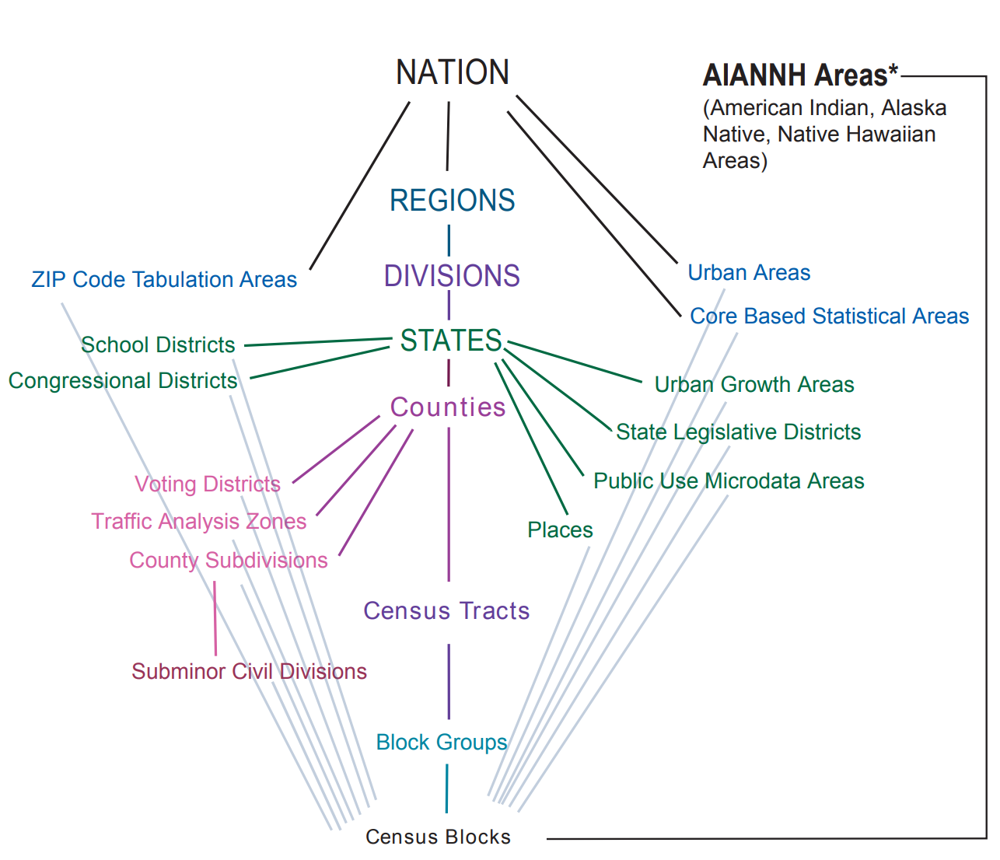</img>

**Common hierarchies**

- State --> county
- State --> place (e.g., cities)
- State --> county --> tract
- State --> county --> tract --> block group

**Tip:** Use the `.geographies` attribute

This allows you to see:

1. What geographies are available for a specific dataset
1. The other required geographies in the heirarchy

In [63]:
acs.geographies['fips']

,name,geoLevelDisplay,referenceDate,requires,wildcard,optionalWithWCFor
0,us,010,2020-01-01,NaN,NaN,NaN
1,region,020,2020-01-01,NaN,NaN,NaN
2,division,030,2020-01-01,NaN,NaN,NaN
3,state,040,2020-01-01,NaN,NaN,NaN
4,county,050,2020-01-01,[state],[state],state
...,...,...,...,...,...,...
82,public use microdata area,795,2020-01-01,[state],[state],state
83,zip code tabulation area,860,2020-01-01,NaN,NaN,NaN
84,school district (elementary),950,2020-01-01,[state],[state],state
85,school district (secondary),960,2020-01-01,[state],[state],state


For the racial dot map, we'll use the most granular available geography: block group.

The hierarchy is: state --> county --> tract --> block group but we can use the `*` operator for tracts so we'll need to know the **FIPS codes for PA and Philadelphia County**

In [64]:
counties = cenpy.explorer.fips_table("COUNTY")
counties.head()

,0,1,2,3,4
0,AL,1,1,Autauga County,H1
1,AL,1,3,Baldwin County,H1
2,AL,1,5,Barbour County,H1
3,AL,1,7,Bibb County,H1
4,AL,1,9,Blount County,H1


In [65]:
# Trim to just Philadelphia
# Search for rows where name contains "Philadelphia"
counties.loc[ counties[3].str.contains("Philadelphia") ]

,0,1,2,3,4
2294,PA,42,101,Philadelphia County,H6


For Philadelphia County, the FIPS codes are:

- Philadelphia County: "101" 
- PA: "42"

In [66]:
philly_county_code = "101"
pa_state_code = "42"

You can also look up FIPS codes on Google! Wikipedia is usually a trustworthy source...

#### Step 5: Build the query (finally)

We'll use the `.query()` function, which takes the following arguments:

1. `cols` - the list of variables desired from the dataset
1. `geo_unit` - string denoting the smallest geographic unit; syntax is "name:FIPS"
1. `geo_filter` - dictionary containing groupings of geo_units, if required by the hierarchy


In [67]:
philly_demo_data = acs.query(
    cols=variables,
    geo_unit="block group:*",
    geo_filter={"state": pa_state_code, 
                "county": philly_county_code, 
                "tract": "*"},
)


philly_demo_data.head()

,NAME,B03002_001E,B03002_003E,B03002_004E,B03002_005E,B03002_006E,B03002_007E,B03002_008E,B03002_009E,B03002_012E,state,county,tract,block group
0,"Block Group 3, Census Tract 1.01, Philadelphia...",0,0,0,0,0,0,0,0,0,42,101,000101,3
1,"Block Group 1, Census Tract 1.02, Philadelphia...",1499,1318,30,0,40,0,0,33,78,42,101,000102,1
2,"Block Group 4, Census Tract 1.02, Philadelphia...",316,316,0,0,0,0,0,0,0,42,101,000102,4
3,"Block Group 2, Census Tract 2, Philadelphia Co...",1090,490,40,0,548,0,0,12,0,42,101,000200,2
4,"Block Group 2, Census Tract 5, Philadelphia Co...",0,0,0,0,0,0,0,0,0,42,101,000500,2


In [68]:
len(philly_demo_data)

1338

**Important:** data is returned as strings rather than numeric values

In [69]:
for variable in variables:
    
    # Convert all variables EXCEPT for NAME
    if variable != "NAME":
        philly_demo_data[variable] = philly_demo_data[variable].astype(float)

**What if we mess up the geographic hierarchy?**

If you forget to include required parts of the geography heirarchy, you'll get an error!

In [70]:
acs.query(
    cols=variables,
    geo_unit="block group:*",
    geo_filter={"state": pa_state_code},
)

/Users/nhand/mambaforge/envs/musa-550-fall-2022/lib/python3.9/site-packages/cenpy/remote.py:224: SyntaxWarning: "is not" with a literal. Did you mean "!="?
  if index is not "":
/Users/nhand/mambaforge/envs/musa-550-fall-2022/lib/python3.9/site-packages/cenpy/remote.py:224: SyntaxWarning: "is not" with a literal. Did you mean "!="?
  if index is not "":


HTTPError: 400 error: unknown/unsupported geography heirarchy

#### Step 6: We need the block group geometries too!

`cenpy` includes an interface to the Census' [Tiger] shapefile database.

In [71]:
cenpy.tiger.available?

Signature: cenpy.tiger.available(verbose=False)
Docstring:
Query the TIGERweb geoAPI for available MapServices

Parameters
-----------
verbose :   int or bool
            indicator for the verbosity level. Accepts levels -1, 0, 1, and greater.

Returns
-------
list or dict of available MapServers through TIGERweb
File:      ~/mambaforge/envs/musa-550-fall-2022/lib/python3.9/site-packages/cenpy/tiger.py
Type:      function


In [72]:
cenpy.tiger.available()

[{'name': 'AIANNHA', 'type': 'MapServer'},
 {'name': 'CBSA', 'type': 'MapServer'},
 {'name': 'Hydro', 'type': 'MapServer'},
 {'name': 'Labels', 'type': 'MapServer'},
 {'name': 'Legislative', 'type': 'MapServer'},
 {'name': 'Places_CouSub_ConCity_SubMCD', 'type': 'MapServer'},
 {'name': 'PUMA_TAD_TAZ_UGA_ZCTA', 'type': 'MapServer'},
 {'name': 'Region_Division', 'type': 'MapServer'},
 {'name': 'School', 'type': 'MapServer'},
 {'name': 'Special_Land_Use_Areas', 'type': 'MapServer'},
 {'name': 'State_County', 'type': 'MapServer'},
 {'name': 'tigerWMS_ACS2012', 'type': 'MapServer'},
 {'name': 'tigerWMS_ACS2013', 'type': 'MapServer'},
 {'name': 'tigerWMS_ACS2014', 'type': 'MapServer'},
 {'name': 'tigerWMS_ACS2015', 'type': 'MapServer'},
 {'name': 'tigerWMS_ACS2016', 'type': 'MapServer'},
 {'name': 'tigerWMS_ACS2017', 'type': 'MapServer'},
 {'name': 'tigerWMS_ACS2018', 'type': 'MapServer'},
 {'name': 'tigerWMS_ACS2019', 'type': 'MapServer'},
 {'name': 'tigerWMS_ACS2021', 'type': 'MapServer'},

Set the tigerWMS_Census2020 database as the desired GeoService.

In [73]:
type(acs)

cenpy.remote.APIConnection

In [74]:
acs.set_mapservice("tigerWMS_Census2020")

Connection to American Community Survey: 5-Year Estimates: Detailed Tables 5-Year(ID: https://api.census.gov/data/id/ACSDT5Y2020)
With MapServer: Census 2020 WMS

The map service has many different layers — select the layer for our desired geography

In [75]:
acs.mapservice.layers

[(ESRILayer) Urban Growth Areas,
 (ESRILayer) Urban Growth Areas Labels,
 (ESRILayer) Tribal Census Tracts,
 (ESRILayer) Tribal Census Tracts Labels,
 (ESRILayer) Tribal Block Groups,
 (ESRILayer) Tribal Block Groups Labels,
 (ESRILayer) Census Tracts,
 (ESRILayer) Census Tracts Labels,
 (ESRILayer) Census Block Groups,
 (ESRILayer) Census Block Groups Labels,
 (ESRILayer) Census Blocks,
 (ESRILayer) Census Blocks Labels,
 (ESRILayer) Unified School Districts,
 (ESRILayer) Unified School Districts Labels,
 (ESRILayer) Secondary School Districts,
 (ESRILayer) Secondary School Districts Labels,
 (ESRILayer) Elementary School Districts,
 (ESRILayer) Elementary School Districts Labels,
 (ESRILayer) Estates,
 (ESRILayer) Estates Labels,
 (ESRILayer) County Subdivisions,
 (ESRILayer) County Subdivisions Labels,
 (ESRILayer) Subbarrios,
 (ESRILayer) Subbarrios Labels,
 (ESRILayer) Consolidated Cities,
 (ESRILayer) Consolidated Cities Labels,
 (ESRILayer) Incorporated Places,
 (ESRILayer) Inco

In [76]:
block_group_geoservice = acs.mapservice.layers[8]

block_group_geoservice

(ESRILayer) Census Block Groups

In [77]:
type(block_group_geoservice)

cenpy.tiger.ESRILayer

In [78]:
block_group_geoservice.variables

,name,type,alias,domain,length
0,OBJECTID,esriFieldTypeOID,OBJECTID,None,NaN
1,AREALAND,esriFieldTypeDouble,AREALAND,None,NaN
2,ALANDHIST,esriFieldTypeDouble,ALANDHIST,None,NaN
3,AREAWATER,esriFieldTypeDouble,AREAWATER,None,NaN
4,AWATERHIST,esriFieldTypeDouble,AWATERHIST,None,NaN
5,BLKGRP,esriFieldTypeString,BLKGRP,None,1.0
6,COUNTY,esriFieldTypeString,COUNTY,None,3.0
7,EFFDATE,esriFieldTypeDate,EFFDATE,None,8.0
8,ESTABDATE,esriFieldTypeDate,ESTABDATE,None,8.0
9,FUNCSTAT,esriFieldTypeString,FUNCSTAT,None,1.0


**Use esri2gpd to load the data**

In [79]:
# The base url for the map service API endpoint
block_group_geoservice._baseurl

'http://tigerweb.geo.census.gov/arcgis/rest/services/TIGERweb/tigerWMS_Census2020/MapServer/8'

In [80]:
## We're just querying a GeoService — let's use esri2gpd

# Only Philadelphia
where_clause = "STATE = '42' AND COUNTY = '101'"

# Query
philly_block_groups = esri2gpd.get(block_group_geoservice._baseurl, where=where_clause)

In [81]:
len(philly_block_groups)

1338

In [82]:
philly_block_groups.head()

,geometry,OBJECTID,AREALAND,ALANDHIST,AREAWATER,AWATERHIST,BLKGRP,COUNTY,EFFDATE,ESTABDATE,FUNCSTAT,GEOID,LSADC,MTFCC,BASENAME,NAME,OID,STATE,TRACT,UR,VINTAGE,CENTLON,CENTLAT,INTPTLON,INTPTLAT,HU100,POP100,STGEOMETRY.AREA,STGEOMETRY.LEN
0,"POLYGON ((-75.05449 40.02465, -75.05405 40.024...",82,305092,305092,0,0,3,101,NaN,NaN,S,421010323003,BG,G5030,3,Block Group 3,208703717019554,42,032300,None,70,-075.0499467,+40.0222676,-075.0499467,+40.0222676,744,1869,520848.611219,3194.678561
1,"POLYGON ((-75.15987 39.94454, -75.15998 39.944...",83,70896,70896,0,0,1,101,NaN,NaN,S,421010011021,BG,G5030,1,Block Group 1,208703717019574,42,001102,None,70,-075.1581610,+39.9449699,-075.1581610,+39.9449699,1180,1729,120760.631816,1390.110306
2,"POLYGON ((-75.00180 40.10493, -75.00165 40.104...",904,423561,417638,0,0,2,101,NaN,NaN,S,421010361002,BG,G5030,2,Block Group 2,20870508933460,42,036100,None,70,-074.9965242,+40.1037503,-074.9965242,+40.1037503,404,1134,724822.503578,3558.455582
3,"POLYGON ((-75.15255 40.00318, -75.15293 40.001...",920,192284,192284,0,0,2,101,NaN,NaN,S,421010200002,BG,G5030,2,Block Group 2,208703717019432,42,020000,None,70,-075.1507409,+40.0042065,-075.1507409,+40.0042065,497,747,328094.605123,3138.906384
4,"POLYGON ((-75.15216 40.01254, -75.15189 40.011...",921,212571,212571,0,0,1,101,NaN,NaN,S,421010203001,BG,G5030,1,Block Group 1,208703717019433,42,020300,None,70,-075.1492793,+40.0091183,-075.1492793,+40.0091183,704,1354,362759.782648,3386.729282


#### Step 7: Merge the demographic data with geometries

Merge based on multiple columns: state, county, tract, and block group IDs.

The relevant columns are: 

- "STATE", "COUNTY", "TRACT", "BLKGRP" in the spatial data
- "state", "county", "tract", "block group" in the non-spatial data

In [83]:
philly_demo_final = philly_block_groups.merge(
    philly_demo_data,
    left_on=["STATE", "COUNTY", "TRACT", "BLKGRP"],
    right_on=["state", "county", "tract", "block group"],
)

In [84]:
philly_demo_final.head()

,geometry,OBJECTID,AREALAND,ALANDHIST,AREAWATER,AWATERHIST,BLKGRP,COUNTY,EFFDATE,ESTABDATE,FUNCSTAT,GEOID,LSADC,MTFCC,BASENAME,NAME_x,OID,STATE,TRACT,UR,VINTAGE,CENTLON,CENTLAT,INTPTLON,INTPTLAT,HU100,POP100,STGEOMETRY.AREA,STGEOMETRY.LEN,NAME_y,B03002_001E,B03002_003E,B03002_004E,B03002_005E,B03002_006E,B03002_007E,B03002_008E,B03002_009E,B03002_012E,state,county,tract,block group
0,"POLYGON ((-75.05449 40.02465, -75.05405 40.024...",82,305092,305092,0,0,3,101,NaN,NaN,S,421010323003,BG,G5030,3,Block Group 3,208703717019554,42,032300,None,70,-075.0499467,+40.0222676,-075.0499467,+40.0222676,744,1869,520848.611219,3194.678561,"Block Group 3, Census Tract 323, Philadelphia ...",1537.0,744.0,439.0,0.0,0.0,0.0,0.0,22.0,332.0,42,101,032300,3
1,"POLYGON ((-75.15987 39.94454, -75.15998 39.944...",83,70896,70896,0,0,1,101,NaN,NaN,S,421010011021,BG,G5030,1,Block Group 1,208703717019574,42,001102,None,70,-075.1581610,+39.9449699,-075.1581610,+39.9449699,1180,1729,120760.631816,1390.110306,"Block Group 1, Census Tract 11.02, Philadelphi...",1742.0,1371.0,84.0,0.0,186.0,0.0,0.0,82.0,19.0,42,101,001102,1
2,"POLYGON ((-75.00180 40.10493, -75.00165 40.104...",904,423561,417638,0,0,2,101,NaN,NaN,S,421010361002,BG,G5030,2,Block Group 2,20870508933460,42,036100,None,70,-074.9965242,+40.1037503,-074.9965242,+40.1037503,404,1134,724822.503578,3558.455582,"Block Group 2, Census Tract 361, Philadelphia ...",935.0,802.0,7.0,0.0,97.0,0.0,0.0,0.0,29.0,42,101,036100,2
3,"POLYGON ((-75.15255 40.00318, -75.15293 40.001...",920,192284,192284,0,0,2,101,NaN,NaN,S,421010200002,BG,G5030,2,Block Group 2,208703717019432,42,020000,None,70,-075.1507409,+40.0042065,-075.1507409,+40.0042065,497,747,328094.605123,3138.906384,"Block Group 2, Census Tract 200, Philadelphia ...",976.0,101.0,722.0,0.0,10.0,0.0,0.0,0.0,143.0,42,101,020000,2
4,"POLYGON ((-75.15216 40.01254, -75.15189 40.011...",921,212571,212571,0,0,1,101,NaN,NaN,S,421010203001,BG,G5030,1,Block Group 1,208703717019433,42,020300,None,70,-075.1492793,+40.0091183,-075.1492793,+40.0091183,704,1354,362759.782648,3386.729282,"Block Group 1, Census Tract 203, Philadelphia ...",1519.0,13.0,1467.0,0.0,12.0,0.0,0.0,0.0,27.0,42,101,020300,1


#### We're done! Plot it to make sure it makes sense

Using `geopandas`...

In [85]:
# Check the CRS
philly_demo_final.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

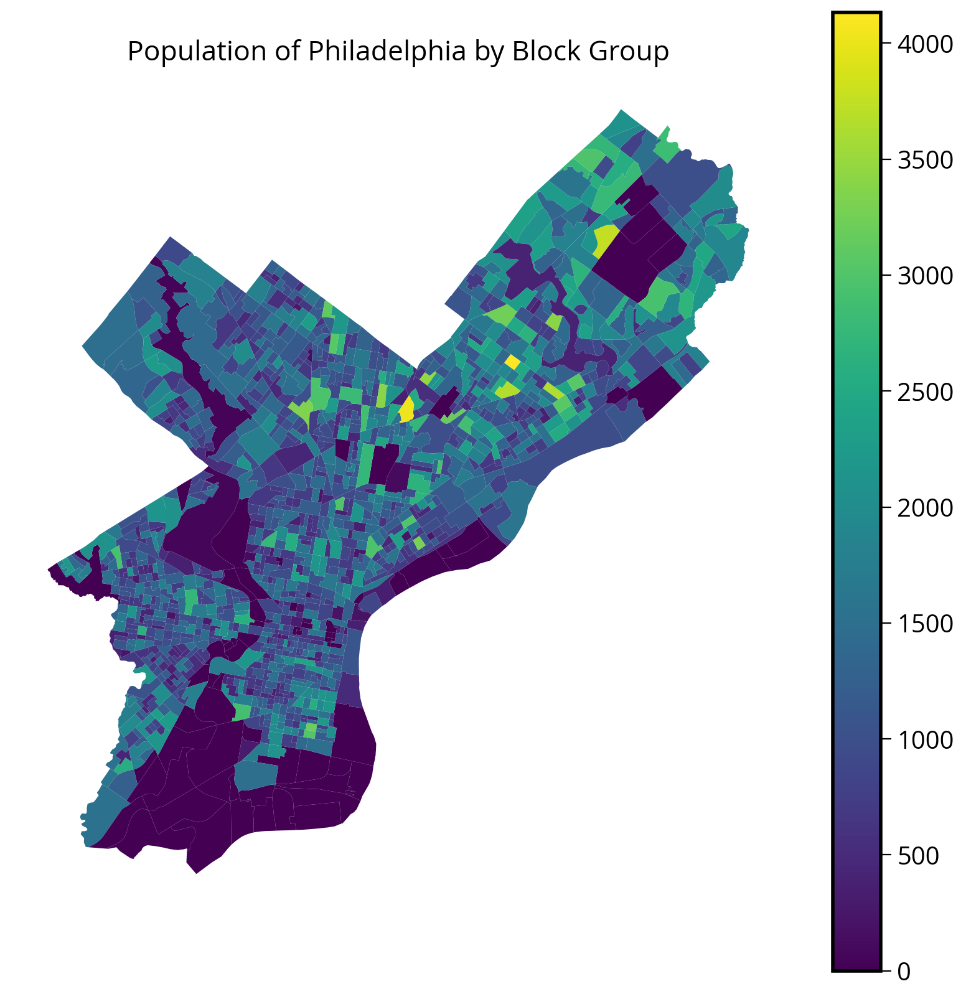

In [86]:
fig, ax = plt.subplots(figsize=(10,10))

# Plot the choropleth
philly_demo_final.plot(ax=ax, column='B03002_001E', legend=True)

# Format
ax.set_title("Population of Philadelphia by Block Group", fontsize=16)
ax.set_axis_off()

Or using `hvplot`...

In [87]:
cols = ['NAME_x', 'B03002_001E', 'geometry']
philly_demo_final[cols].hvplot(c='B03002_001E',
                              geo=True, 
                              legend=True,
                              width=600, 
                              height=400, 
                              cmap='viridis',
                              frame_height=800, 
                              frame_width=800, 
                              hover_cols=["NAME_x"])

:Polygons   [Longitude,Latitude]   (B03002_001E,NAME_x)

#### Now let's prep the data for the dot map

1. Rename columns to more user-friendly versions
1. Add a general "Other" category

In [88]:
# Rename columns
philly_demo_final = philly_demo_final.rename(
    columns={
        "B03002_001E": "Total",  # Total
        "B03002_003E": "White",  # Not Hispanic, White
        "B03002_004E": "Black",  # Not Hispanic, Black
        "B03002_005E": "AI/AN",  # Not Hispanic, American Indian
        "B03002_006E": "Asian",  # Not Hispanic, Asian
        "B03002_007E": "NH/PI",  # Not Hispanic, Native Hawaiian
        "B03002_008E": "Other_",  # Not Hispanic, Other
        "B03002_009E": "Two Plus",  # Not Hispanic, Two or More Races
        "B03002_012E": "Hispanic",  # Hispanic
    }
)

In [89]:
# Add an "Other" column 
cols = ['AI/AN', 'NH/PI','Other_', 'Two Plus']
philly_demo_final['Other'] = philly_demo_final[cols].sum(axis=1)

#### Define a function to create random points

Given a polygon, create randomly distributed points that fall within the polygon.

In [90]:
def random_points_in_polygon(number, polygon):
    """
    Generate a random number of points within the 
    specified polygon.
    """
    points = []
    min_x, min_y, max_x, max_y = polygon.bounds
    i= 0
    while i < number:
        point = Point(np.random.uniform(min_x, max_x), np.random.uniform(min_y, max_y))
        if polygon.contains(point):
            points.append(point)
            i += 1
    return points

**Random points example**

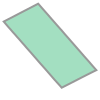

In [91]:
# get the first block group polygon in the data set
geo = philly_demo_final.iloc[0].geometry

geo

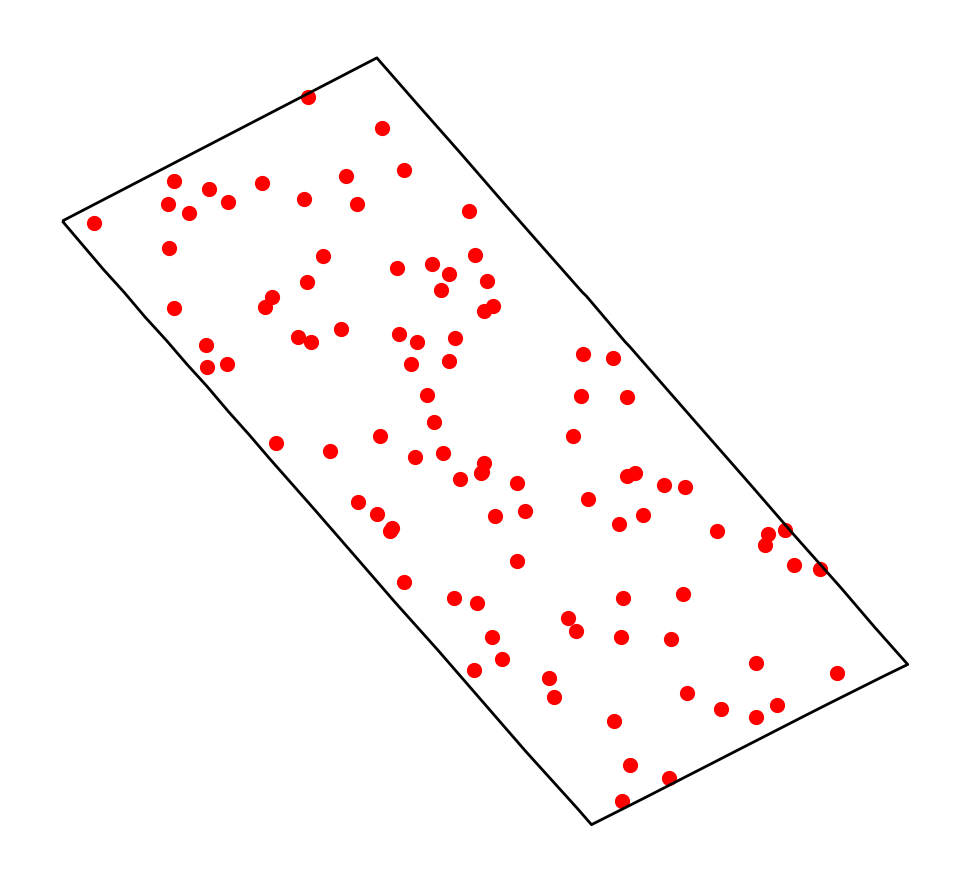

In [92]:
fig, ax = plt.subplots(figsize=(6, 6))

# Generate some random points
random_points = random_points_in_polygon(100, geo)

# Plot random points
gpd.GeoSeries(random_points).plot(ax=ax, markersize=20, color="red")

# Plot boundary of block group
gpd.GeoSeries([geo]).plot(ax=ax, facecolor="none", edgecolor="black")

ax.set_axis_off()

In [93]:
def generate_dot_map(data, people_per_dot):
    """
    Given a GeoDataFrame with demographic columns, generate a dot 
    map according to the population in each geometry.
    """
    results = []
    for field in ["White", "Hispanic", "Black", "Asian", "Other"]:

        # generate random points
        pts = data.apply(
            lambda row: random_points_in_polygon(
                row[field] / people_per_dot, row["geometry"]
            ),
            axis=1,
        )

        # combine into single GeoSeries
        pts = gpd.GeoSeries(pts.apply(pd.Series).stack(), dtype=object, crs=data["geometry"].crs)
        pts.name = "geometry"

        # make into a GeoDataFrame
        pts = gpd.GeoDataFrame(pts)
        pts["field"] = field

        # save
        results.append(pts)

    return gpd.GeoDataFrame(pd.concat(results), crs=data["geometry"].crs).reset_index(
        drop=True
    )

#### Calculate the dot map

In [94]:
dot_map = generate_dot_map(philly_demo_final, people_per_dot=50)

/Users/nhand/mambaforge/envs/musa-550-fall-2022/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)
/var/folders/49/ntrr94q12xd4rq8hqdnx96gm0000gn/T/ipykernel_13687/2645225740.py:18: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  pts = gpd.GeoSeries(pts.apply(pd.Series).stack(), dtype=object, crs=data["geometry"].crs)
/Users/nhand/mambaforge/envs/musa-550-fall-2022/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)
/var/folders/49/ntrr94q12xd4rq8hqdnx96

In [95]:
print("number of points = ", len(dot_map))

number of points =  34143


In [96]:
dot_map.tail()

,geometry,field
34138,POINT (-75.07955 40.01939),Other
34139,POINT (-75.24719 39.96220),Other
34140,POINT (-75.08613 40.02940),Other
34141,POINT (-75.05695 40.01857),Other
34142,POINT (-75.21972 39.92888),Other


#### Now let's plot it

In [97]:
# setup a custom color map from ColorBrewer
from matplotlib.colors import ListedColormap

cmap = ListedColormap(
    ["#3a833c", "#377eb8", "#4daf4a", "#984ea3", "#ff7f00", "#ffff33"]
)

In [98]:
# Convert to 3857
dot_map_3857 = dot_map.to_crs(epsg=3857)

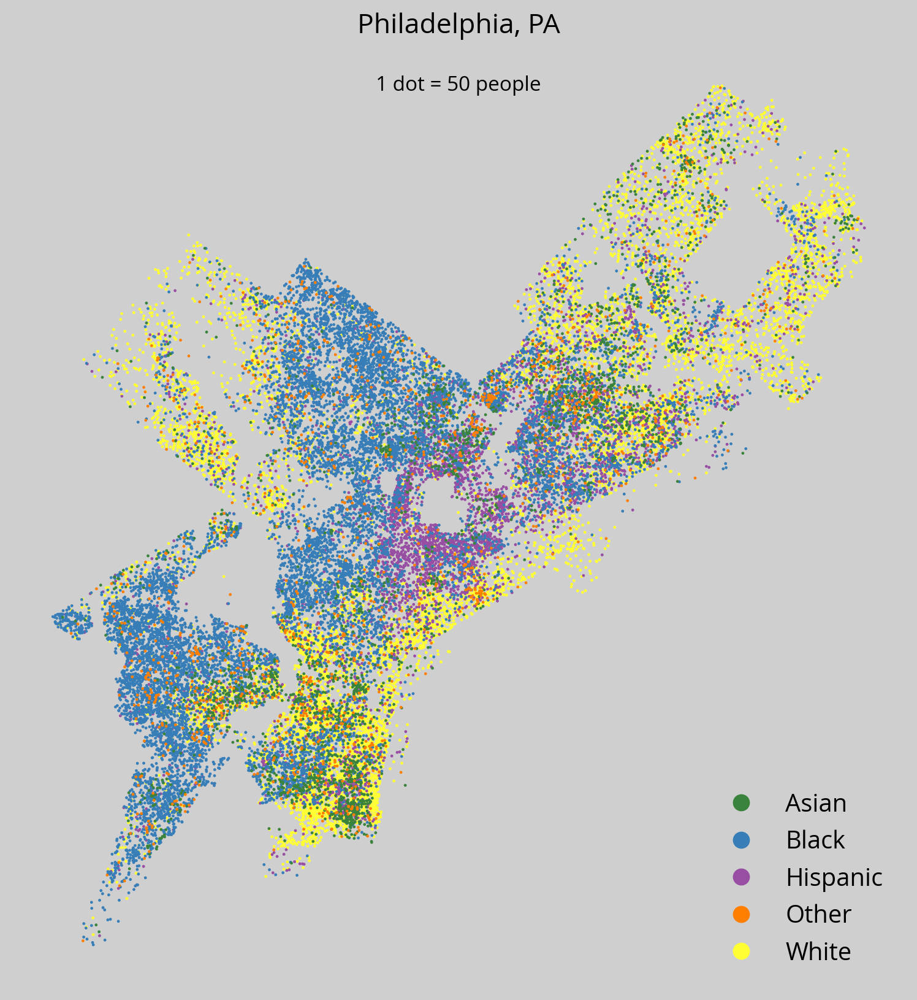

In [99]:
# Initialize the figure and axes
fig, ax = plt.subplots(figsize=(10, 10), facecolor="#cfcfcf")

# Plot
dot_map_3857.plot(
    ax=ax,
    column="field",
    categorical=True,
    legend=True,
    alpha=1,
    markersize=0.5,
    cmap=cmap,
)

# format
ax.set_title("Philadelphia, PA", fontsize=16)
ax.text(
    0.5, 0.95, "1 dot = 50 people", fontsize=12, transform=ax.transAxes, ha="center"
)
ax.set_axis_off()

## At home exercise: lead poisoning in Philadelphia

Let's use demographic census data in Philadelphia by **census tract** and compare to a dataset of childhood lead poisoning.

### Step 1. Download the demographic data for Philadelphia

- We are going to be examining the percent of the population that identifies as black in each census tract, so we will need:
    - Total population: 'B03002_001E'
    - Non-Hispanic, Black population: 'B03002_004E'
- You'll want to use the state --> county --> tract hierarchy , using the `*` operator to get all tracts in Philadelphia county   
- Remember PA has a FIPS code of "42" and Philadelphia County is "101"

In [100]:
philly_demo_tract = acs.query(
    cols=["NAME", "B03002_001E", "B03002_004E"],
    geo_unit="tract:*",
    geo_filter={
                "state" : "42", 
                "county" : "101"
               },
)

In [101]:
philly_demo_tract.head()

,NAME,B03002_001E,B03002_004E,state,county,tract
0,"Census Tract 27.01, Philadelphia County, Penns...",4098,368,42,101,002701
1,"Census Tract 27.02, Philadelphia County, Penns...",4300,124,42,101,002702
2,"Census Tract 28.01, Philadelphia County, Penns...",4452,294,42,101,002801
3,"Census Tract 28.02, Philadelphia County, Penns...",5772,221,42,101,002802
4,"Census Tract 29, Philadelphia County, Pennsylv...",3762,50,42,101,002900


In [102]:
philly_demo_tract.dtypes # "object" means string!

NAME           object
B03002_001E    object
B03002_004E    object
state          object
county         object
tract          object
dtype: object

### Step 2. Download and merge in the census tract geometries

In [103]:
# Census tracts are the 7th layer (index 6 starting from 0)
acs.mapservice.layers[6]

(ESRILayer) Census Tracts

#### Use esri2gpd to load the data

In [104]:
# The base url for the map service API endpoint
url = acs.mapservice.layers[6]._baseurl

url

'http://tigerweb.geo.census.gov/arcgis/rest/services/TIGERweb/tigerWMS_Census2020/MapServer/6'

In [105]:
## We're just querying a GeoService — let's use esri2gpd

# Only Philadelphia
where_clause = "STATE = '42' AND COUNTY = '101'"

# Query
philly_census_tracts = esri2gpd.get(url, where=where_clause)

In [106]:
# Merge them together
# IMPORTANT: Make sure your merge keys are the same dtypes (e.g., all strings or all ints)
philly_demo_tract = philly_census_tracts.merge(
    philly_demo_tract,
    left_on=["STATE", "COUNTY", "TRACT"],
    right_on=["state", "county", "tract"],
)

### Step 3. Calculate the black percentage

Add a new column to your data called `percent_black`.

**Important:** Make sure you convert the data to floats!

In [107]:
for col in ['B03002_001E', 'B03002_004E']:
    philly_demo_tract[col] = philly_demo_tract[col].astype(float)

In [108]:
philly_demo_tract["percent_black"] = (
    100 * philly_demo_tract["B03002_004E"] / philly_demo_tract["B03002_001E"]
)

### Step 4. Query CARTO to get the childhood lead levels by census tract

- The API documentation for this data is here: https://cityofphiladelphia.github.io/carto-api-explorer/#child_blood_lead_levels_by_ct
- You can use the `carto2gpd` package
    - You'll need the API endpoint for CARTO and the name of the table

In [109]:
# Documentation includes an example for help!
# carto2gpd.get?

In [110]:
table_name = 'child_blood_lead_levels_by_ct'
lead_levels = carto2gpd.get("https://phl.carto.com/api/v2/sql", table_name)

In [111]:
lead_levels.head()

,geometry,cartodb_id,census_tract,data_redacted,num_bll_5plus,num_screen,perc_5plus
0,"POLYGON ((-75.14147 39.95171, -75.14150 39.951...",1,42101000100,False,0.0,100.0,0.0
1,"POLYGON ((-75.16238 39.95766, -75.16236 39.957...",2,42101000200,True,NaN,109.0,NaN
2,"POLYGON ((-75.17821 39.95981, -75.17743 39.959...",3,42101000300,True,NaN,110.0,NaN
3,"POLYGON ((-75.17299 39.95464, -75.17301 39.954...",4,42101000401,True,NaN,61.0,NaN
4,"POLYGON ((-75.16333 39.95334, -75.16340 39.953...",5,42101000402,False,0.0,41.0,0.0


### Step 5. Remove census tracts with missing lead measurements

See the `.dropna()` function and the `subset=` keyword.

In [112]:
lead_levels = lead_levels.dropna(subset=['perc_5plus'])

### Step 6. Merge the demographic and lead level data frames

- From the lead data, we only need the 'census_tract' and 'perc_5plus'. Before merging, trim your data to only these columns.
- You can perform the merge by comparing the `census_tract` and `GEOID` fields
- Remember: when merging, the left data frame should be the GeoDataFrame — use `GeoDataFrame.merge(...)`

In [113]:
# Trim the lead levels data
lead_levels_trimmed = lead_levels[['census_tract', 'perc_5plus']]

# Merge into the demographic data
# Use "GEOID" — that is the unique identifier here
merged = philly_demo_tract.merge(lead_levels_trimmed, 
                                 how='left', 
                                 left_on='GEOID', 
                                 right_on='census_tract')

In [114]:
merged.head()

,geometry,OBJECTID,AREALAND,ALANDHIST,AREAWATER,AWATERHIST,COUNTY,EFFDATE,ESTABDATE,FUNCSTAT,GEOID,LSADC,MTFCC,BASENAME,NAME_x,OID,STATE,TRACT,UR,VINTAGE,CENTLON,CENTLAT,INTPTLON,INTPTLAT,HU100,POP100,STGEOMETRY.AREA,STGEOMETRY.LEN,NAME_y,B03002_001E,B03002_004E,state,county,tract,percent_black,census_tract,perc_5plus
0,"POLYGON ((-75.02371 40.13005, -75.02489 40.129...",669,1816210,1816210,7169,7169,101,NaN,NaN,S,42101036501,CT,G5020,365.01,Census Tract 365.01,207703717001577,42,036501,None,70,-075.0131963,+40.1293202,-075.0122761,+40.1288937,2520,5698,3.122595e+06,7152.056313,"Census Tract 365.01, Philadelphia County, Penn...",4799.0,538.0,42,101,036501,11.210669,NaN,NaN
1,"POLYGON ((-75.18329 39.94951, -75.18275 39.949...",673,99957,99957,12755,12755,101,NaN,NaN,S,42101000801,CT,G5020,8.01,Census Tract 8.01,207703717001596,42,000801,None,70,-075.1800509,+39.9500600,-075.1804054,+39.9497374,1195,1748,1.920198e+05,1800.716073,"Census Tract 8.01, Philadelphia County, Pennsy...",1631.0,26.0,42,101,000801,1.594114,NaN,NaN
2,"POLYGON ((-75.16899 40.07147, -75.16892 40.071...",2651,406340,406054,0,0,101,NaN,NaN,S,42101026301,CT,G5020,263.01,Census Tract 263.01,20770510238026,42,026301,None,70,-075.1637161,+40.0728148,-075.1637161,+40.0728148,1656,3726,6.947209e+05,3399.391181,"Census Tract 263.01, Philadelphia County, Penn...",3772.0,3435.0,42,101,026301,91.065748,42101026301,3.6
3,"POLYGON ((-75.16912 40.02386, -75.16848 40.023...",2662,421189,421189,0,0,101,NaN,NaN,S,42101024400,CT,G5020,244,Census Tract 244,20770510183838,42,024400,None,70,-075.1638925,+40.0248284,-075.1638925,+40.0248284,1374,3152,7.191082e+05,3469.999759,"Census Tract 244, Philadelphia County, Pennsyl...",3453.0,2779.0,42,101,024400,80.480741,42101024400,11.3
4,"POLYGON ((-75.05465 40.04464, -75.05449 40.044...",2664,842716,828420,0,0,101,NaN,NaN,S,42101033200,CT,G5020,332,Census Tract 332,20770510237205,42,033200,None,70,-075.0449684,+40.0439733,-075.0449684,+40.0439733,1046,3292,1.439592e+06,5498.109229,"Census Tract 332, Philadelphia County, Pennsyl...",2951.0,94.0,42,101,033200,3.185361,42101033200,0.0


### Step 7. Trim to the columns we need

We only need the 'geometry', 'percent_black', and 'perc_5plus', and 'NAME' columns

In [115]:
merged = merged[['NAME_x', 'geometry', 'percent_black', 'perc_5plus']]

### Step 8. Plot the results

Make two plots:

1. A two panel, side-by-side chart showing a choropleth of the lead levels and the percent black
1. A scatter plot showing the percentage 

You can make these using hvplot or geopandas/matplotlib — whichever you prefer!

In [116]:
# Lead levels plot
img1 = merged.hvplot(geo=True, 
                     c='perc_5plus', 
                     width=500, 
                     height=400, 
                     cmap='viridis', 
                     title='Lead Levels')

# Percent black 
img2 = merged.hvplot(geo=True,
                     c='percent_black', 
                     width=500, 
                     height=400, 
                     cmap='viridis', 
                     title='% Black')

img1 + img2

:Layout
   .Polygons.I  :Polygons   [Longitude,Latitude]   (perc_5plus)
   .Polygons.II :Polygons   [Longitude,Latitude]   (percent_black)

In [117]:
cols = ["perc_5plus", "percent_black"]
merged[cols].hvplot.scatter(x=cols[0], y=cols[1])

:Scatter   [perc_5plus]   (percent_black)

### Challenge: Step 9. Use seaborn to plot a 2d density map

In the previous plots, it's still hard to see the relationship. Use the `kdeplot()` function in `seaborn` to better visualize the relationship.

You will need to remove any NaN entries first.

You should see two peaks in the distribution clearly now!

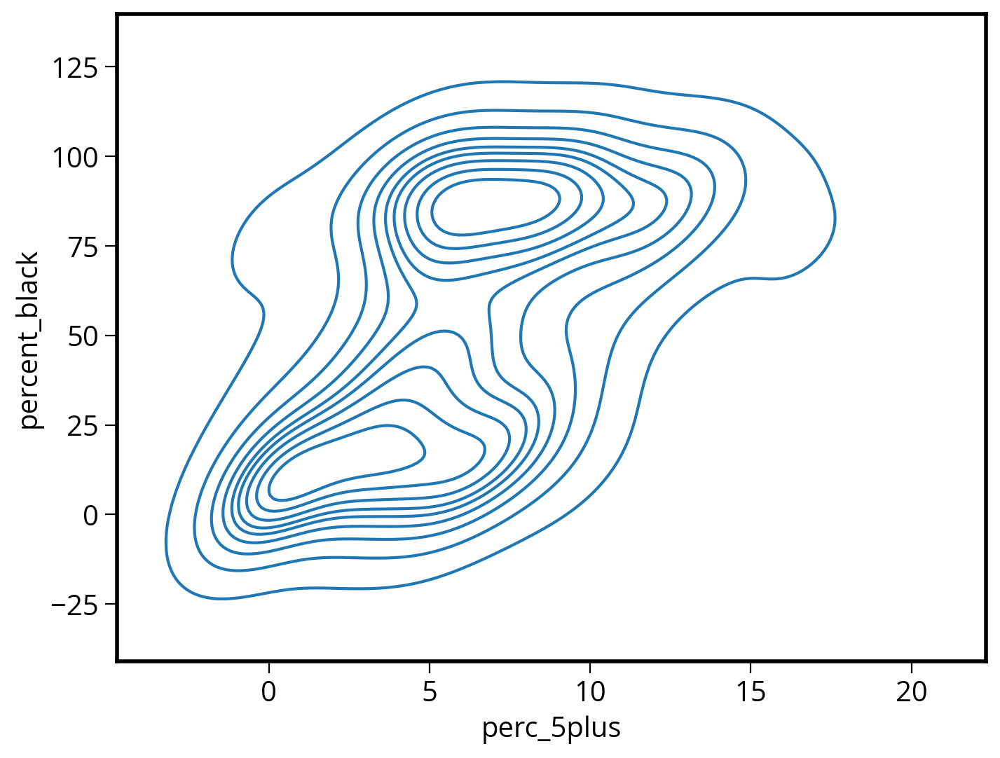

In [118]:
fig, ax = plt.subplots(figsize=(8,6))

X = merged.dropna()
sns.kdeplot(x=X['perc_5plus'], y=X['percent_black'], ax=ax);